Business Objective:

PJM Hourly Energy Consumption Data
PJM Interconnection LLC (PJM) is a regional transmission organization (RTO) in the United States. It is part of the Eastern Interconnection grid operating an electric transmission system serving all or parts of Delaware, Illinois, Indiana, Kentucky, Maryland, Michigan, New Jersey, North Carolina, Ohio, Pennsylvania, Tennessee, Virginia, West Virginia, and the District of Columbia.

The hourly power consumption data comes from PJM's website and are in megawatts (MW).

The regions have changed over the years so data may only appear for certain dates per region.

●	Split the last year into a test set- can you build a model to predict energy consumption?
●	Find trends in energy consumption around hours of the day, holidays, or long term trends?
●	Understand how daily trends change depending of the time of year. Summer trends are very different than winter trends.
●	Forecast for next 30 days.


# importing required lib's

In [2]:
#impoorting basic required lib's
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Exploratory analysis of time series data

# Extracting the data

In [3]:
#reading the datasets using pandas 
df=pd.read_excel('PJMW_MW_Hourly.xlsx')
df.head()

,Datetime,PJMW_MW
0,2002-12-31 01:00:00,5077
1,2002-12-31 02:00:00,4939
2,2002-12-31 03:00:00,4885
3,2002-12-31 04:00:00,4857
4,2002-12-31 05:00:00,4930


In [4]:
#size of the Datasets
df.shape

(143206, 2)

In [5]:
#checking the null values
df.isnull().sum()

Datetime    0
PJMW_MW     0
dtype: int64

In [6]:
#checking the datatypes of the variables or an attributes
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 143206 entries, 0 to 143205
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   Datetime  143206 non-null  datetime64[ns]
 1   PJMW_MW   143206 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 2.2 MB


In [7]:
#creating the new column for futher mainly for ploting
df['Date']=df['Datetime'].dt.date
df['year']=df['Datetime'].dt.year
df['month']=df['Datetime'].dt.month
df['hour']=df['Datetime'].dt.hour
df['name_of_week']=df['Datetime'].dt.weekday
df['season']=df['Datetime'].apply(lambda x: 'Winter' if x.month == 12 or x.month == 1 or x.month == 2  else 'Spring' if x.month==3 or x.month==4 or x.month==5 else 'Summer' if x.month==6 or x.month==7 or x.month==8 else 'Autumn' if x.month==9 or x.month==10 or x.month==11 else "")

In [8]:
#looking the datasets
print('size of the datasets',df.shape)
df.head()

size of the datasets (143206, 8)


,Datetime,PJMW_MW,Date,year,month,hour,name_of_week,season
0,2002-12-31 01:00:00,5077,2002-12-31,2002,12,1,1,Winter
1,2002-12-31 02:00:00,4939,2002-12-31,2002,12,2,1,Winter
2,2002-12-31 03:00:00,4885,2002-12-31,2002,12,3,1,Winter
3,2002-12-31 04:00:00,4857,2002-12-31,2002,12,4,1,Winter
4,2002-12-31 05:00:00,4930,2002-12-31,2002,12,5,1,Winter


In [9]:
#setting index as Datetime
df=df.set_index('Datetime')

# Plot the time series

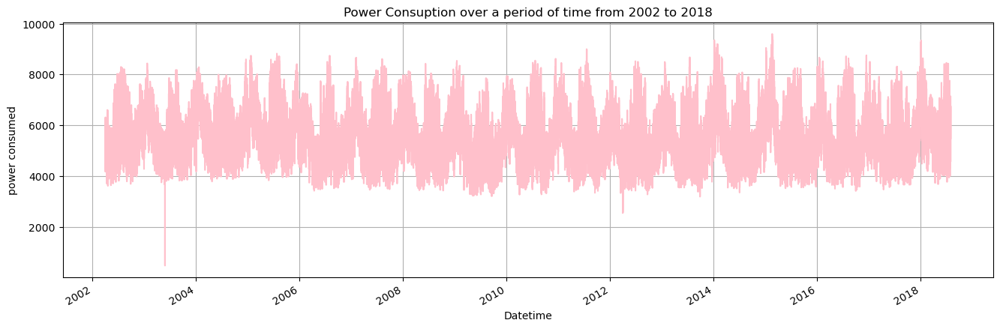

In [10]:
#ok lets see the plots how the power conspution varies with time

df['PJMW_MW'].plot(title='Power Consuption over a period of time from 2002 to 2018',figsize=(16,5),c='pink',ylabel='power consumed',grid=True);

<AxesSubplot:xlabel='Datetime', ylabel='PJMW_MW'>

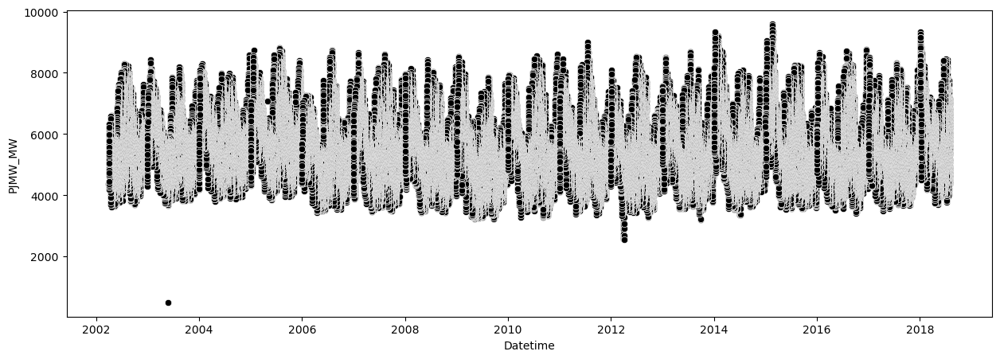

In [11]:
plt.figure(figsize=(15,5))
sns.scatterplot(data=df.iloc[:,0],color='black')

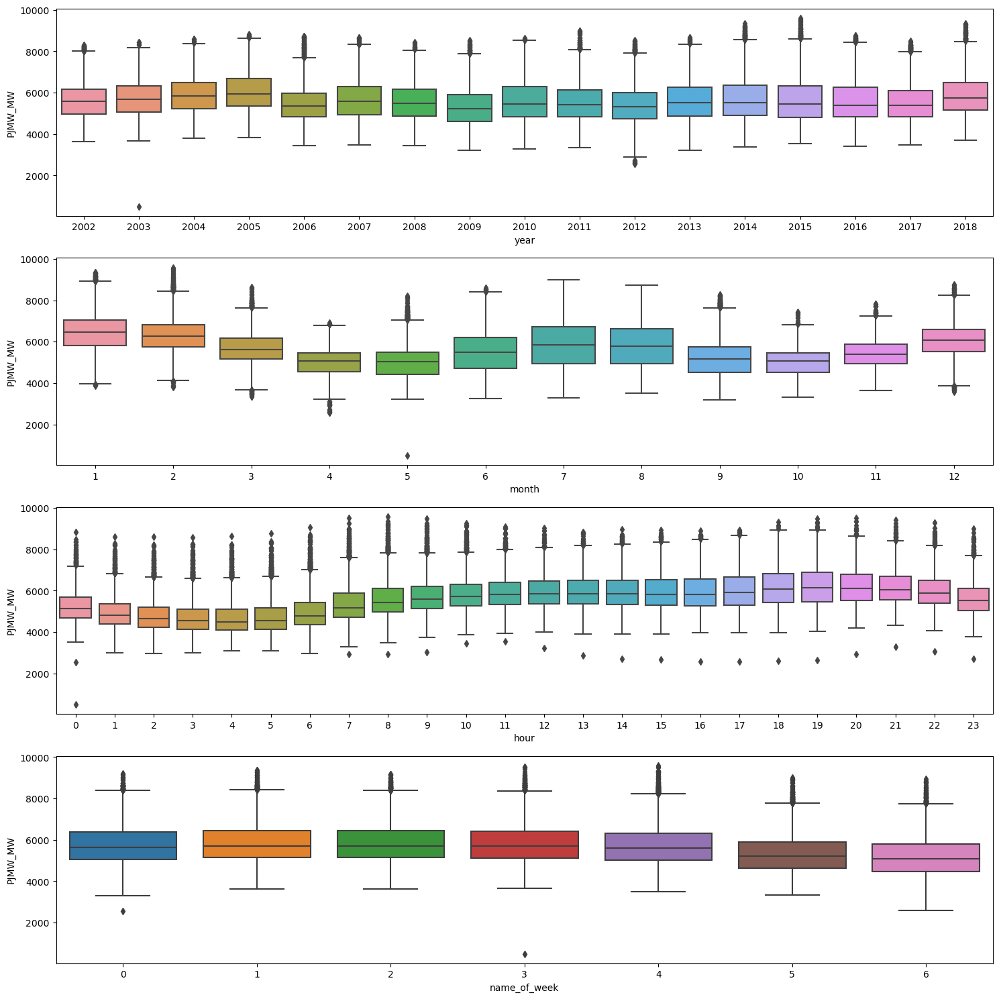

In [12]:
import seaborn as sns
fig, axes = plt.subplots(4,1,figsize=(15, 15), sharey=True)
sns.boxplot(ax=axes[0],x=df['year'],y=df['PJMW_MW'])
sns.boxplot(ax=axes[1],x=df['month'],y=df['PJMW_MW'])
sns.boxplot(ax=axes[2],x=df['hour'],y=df['PJMW_MW'])
sns.boxplot(ax=axes[3],x=df['name_of_week'],y=df['PJMW_MW'])

plt.tight_layout()
plt.show()


<AxesSubplot:xlabel='PJMW_MW', ylabel='Count'>

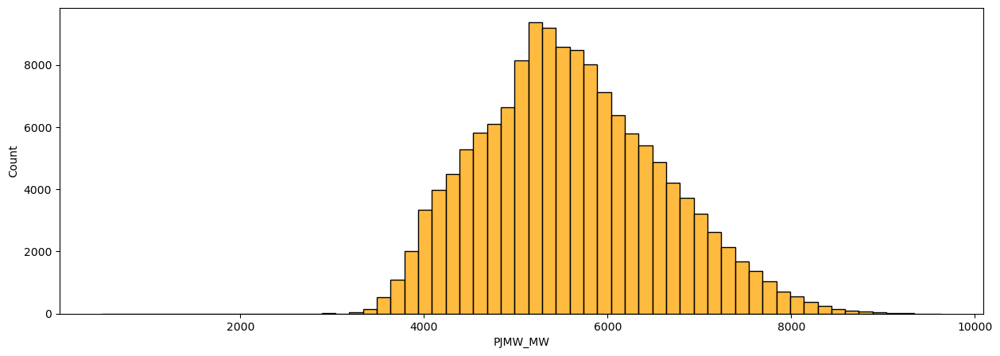

In [13]:
import seaborn as sns
plt.figure(figsize=(15, 5))
sns.histplot(df['PJMW_MW'],color='orange',binwidth=150,cbar='black')


C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='PJMW_MW', ylabel='Density'>

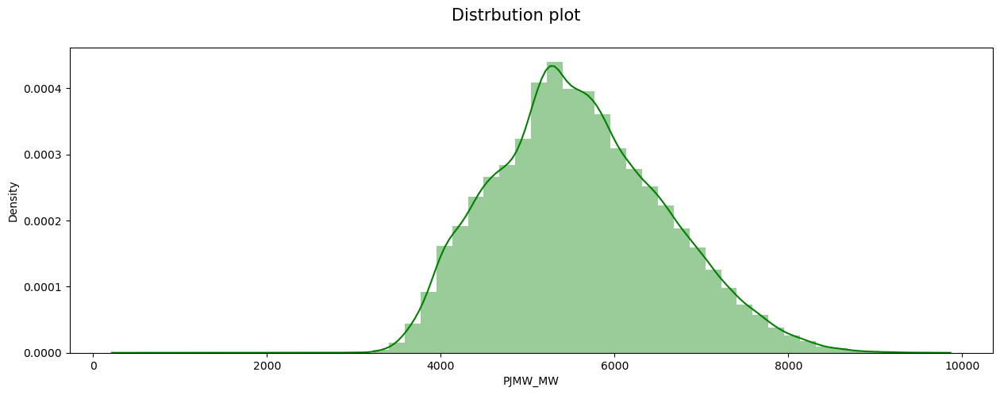

In [14]:
plt.figure(figsize=(15, 5))
plt.suptitle('Distrbution plot',fontsize=15)
sns.distplot(df['PJMW_MW'],color='green')

In [15]:
print('skewness of power consuption :',df['PJMW_MW'].skew())
print('peakness of power consuption :',df['PJMW_MW'].kurtosis())

skewness of power consuption : 0.3348532861122116
peakness of power consuption : -0.2214559469116555


In [16]:
#lets find the datatypes of all attributes or variable

df.dtypes

PJMW_MW          int64
Date            object
year             int64
month            int64
hour             int64
name_of_week     int64
season          object
dtype: object

In [17]:
#converting Date object as Datetime datatype
df['Date']=pd.to_datetime(df['Date'])

In [18]:
#lets find the datatypes of all attributes or variable

df.dtypes

PJMW_MW                  int64
Date            datetime64[ns]
year                     int64
month                    int64
hour                     int64
name_of_week             int64
season                  object
dtype: object

In [19]:
df.describe()

,PJMW_MW,year,month,hour,name_of_week
count,143206.000000,143206.000000,143206.000000,143206.000000,143206.000000
mean,5602.375089,2009.918691,6.502835,11.501620,2.998492
std,979.142872,4.730344,3.419536,6.921789,1.999696
min,487.000000,2002.000000,1.000000,0.000000,0.000000
25%,4907.000000,2006.000000,4.000000,6.000000,1.000000
50%,5530.000000,2010.000000,6.000000,12.000000,3.000000
75%,6252.000000,2014.000000,9.000000,18.000000,5.000000
max,9594.000000,2018.000000,12.000000,23.000000,6.000000


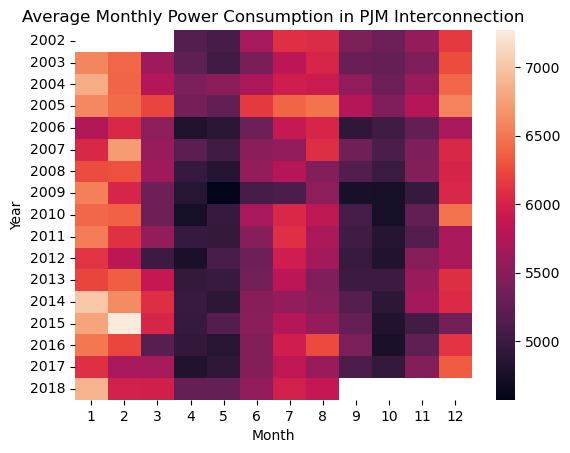

In [20]:
monthly_consumption = df.groupby(['year', 'month'])['PJMW_MW'].mean().unstack()
sns.heatmap(monthly_consumption)
plt.title('Average Monthly Power Consumption in PJM Interconnection')
plt.xlabel('Month')
plt.ylabel('Year')
plt.show()

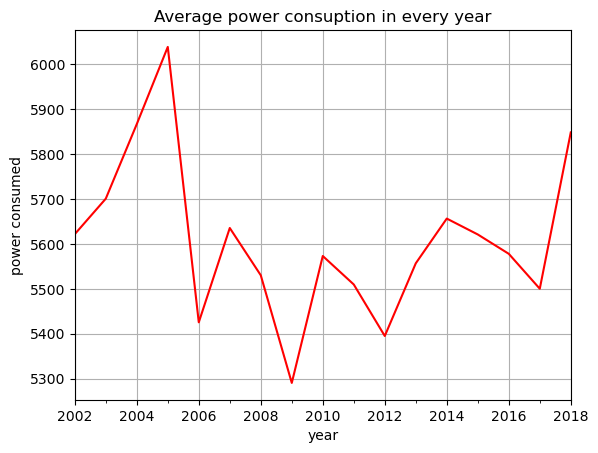

In [21]:
df['PJMW_MW'].resample('y').mean().plot(kind='line',title='Average power consuption in every year',c='red',ylabel='power consumed',xlabel='year',y='Average power consumed over years',grid=True);

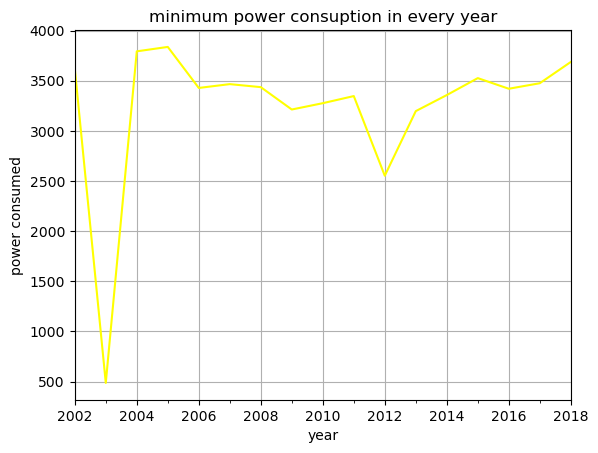

In [22]:
df['PJMW_MW'].resample('y').min().plot(title='minimum power consuption in every year',c='yellow',ylabel='power consumed',xlabel='year',y='Average power consumed over years',grid=True);

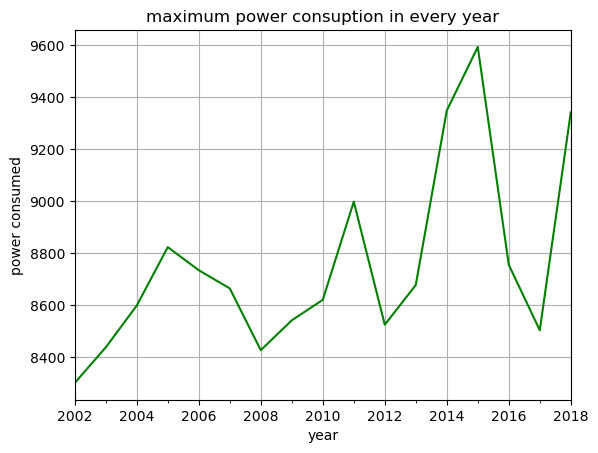

In [23]:
df['PJMW_MW'].resample('y').max().plot(title='maximum power consuption in every year',c='green',ylabel='power consumed',xlabel='year',y='Average power consumed over years',grid=True);

<AxesSubplot:title={'center':'Power consuption'}, xlabel='year,month'>

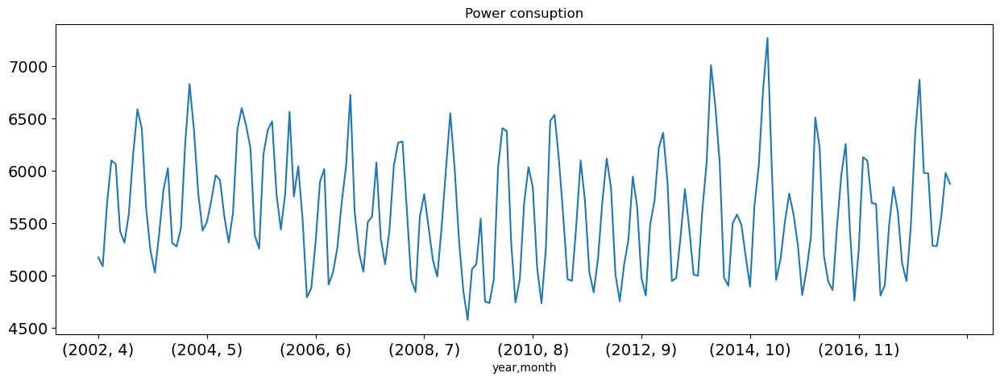

In [24]:
temp=df.groupby(['year', 'month'])['PJMW_MW'].mean() 
temp.plot(figsize=(15,5), title= 'Power consuption', fontsize=14)

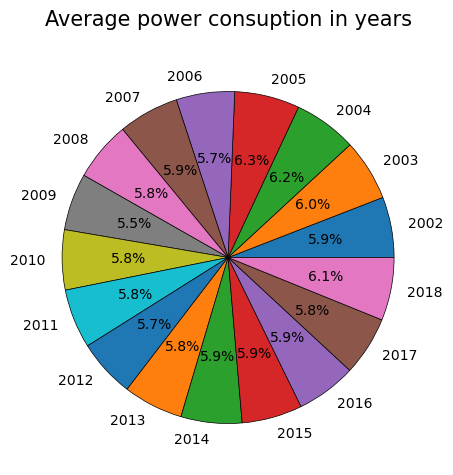

In [25]:
#year wise power consuption
year=df.year.unique()
value=[df[df['year']==2002]['PJMW_MW'].mean(),df[df['year']==2003]['PJMW_MW'].mean(),df[df['year']==2004]['PJMW_MW'].mean(),df[df['year']==2005]['PJMW_MW'].mean(),df[df['year']==2006]['PJMW_MW'].mean(),df[df['year']==2007]['PJMW_MW'].mean(),df[df['year']==2008]['PJMW_MW'].mean(),df[df['year']==2009]['PJMW_MW'].mean(),df[df['year']==2010]['PJMW_MW'].mean(),df[df['year']==2011]['PJMW_MW'].mean(),df[df['year']==2012]['PJMW_MW'].mean(),df[df['year']==2013]['PJMW_MW'].mean(),df[df['year']==2014]['PJMW_MW'].mean(),df[df['year']==2015]['PJMW_MW'].mean(),df[df['year']==2016]['PJMW_MW'].mean(),df[df['year']==2017]['PJMW_MW'].mean(),df[df['year']==2018]['PJMW_MW'].mean()]
wp = { 'linewidth' : 0.5, 'edgecolor' : "black" }
def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%".format(pct, absolute)

plt.suptitle('Average power consuption in years',fontsize=15)
plt.pie(value,autopct = lambda pct: func(pct, df['PJMW_MW']),labels=year,wedgeprops = wp);
plt.tight_layout()

In [26]:
new_d=df
new_d['month']=df['month'].apply(lambda x: 'Jan' if x==1 else 'Feb' if x==2 else 'March'if x==3 else 'April' if x==4 else 'May' if x==5 else 'June' if x==6 else 'July' if x==7 else 'Aug' if x==8 else 'Sep' if x==9 else 'Oct' if x==10 else 'Nov'  if x==11 else 'Dec' if x==12 else '') 
new_d.month.unique()

array(['Dec', 'Jan', 'Nov', 'Oct', 'Sep', 'Aug', 'July', 'June', 'May',
       'April', 'March', 'Feb'], dtype=object)

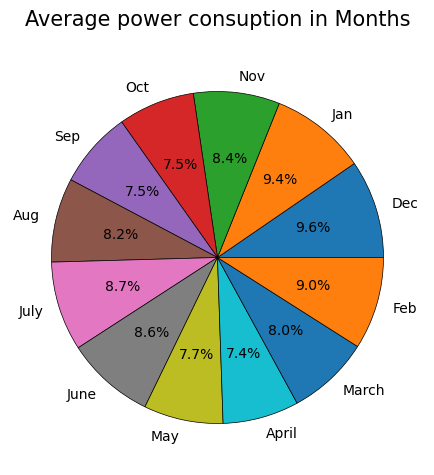

In [27]:
months=[new_d[new_d['month']=='Jan']['PJMW_MW'].mean(),new_d[new_d['month']=='Feb']['PJMW_MW'].mean(),new_d[new_d['month']=='March']['PJMW_MW'].mean(),new_d[new_d['month']=='April']['PJMW_MW'].mean(),new_d[new_d['month']=='May']['PJMW_MW'].mean(),new_d[new_d['month']=='June']['PJMW_MW'].mean(),new_d[new_d['month']=='July']['PJMW_MW'].mean(),new_d[new_d['month']=='Aug']['PJMW_MW'].mean(),new_d[new_d['month']=='Sep']['PJMW_MW'].mean(),new_d[new_d['month']=='Oct']['PJMW_MW'].mean(),new_d[new_d['month']=='Nov']['PJMW_MW'].mean(),new_d[new_d['month']=='Dec']['PJMW_MW'].mean()]
label=new_d.month.unique()
plt.suptitle('Average power consuption in Months',fontsize=15)
plt.pie(months,autopct = lambda pct: func(pct, df['PJMW_MW']),labels=label,wedgeprops = wp);
plt.tight_layout()

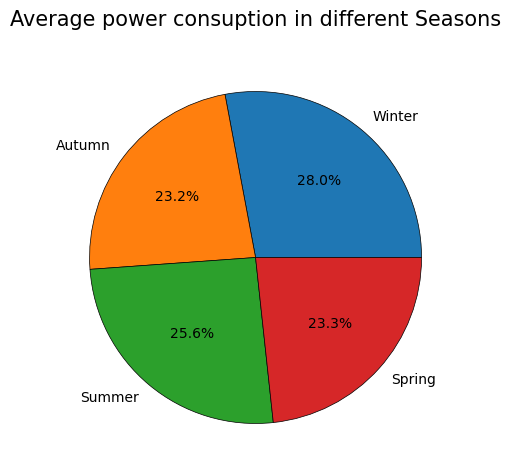

In [28]:
season=[df[df['season']=='Winter']['PJMW_MW'].mean(),df[df['season']=='Autumn']['PJMW_MW'].mean(),df[df['season']=='Summer']['PJMW_MW'].mean(),df[df['season']=='Spring']['PJMW_MW'].mean()]
label=['Winter', 'Autumn', 'Summer', 'Spring']
plt.suptitle('Average power consuption in different Seasons',fontsize=15)
plt.pie(season,autopct = lambda pct: func(pct, df['PJMW_MW']),labels=label,wedgeprops = wp);
plt.tight_layout()

<AxesSubplot:xlabel='month'>

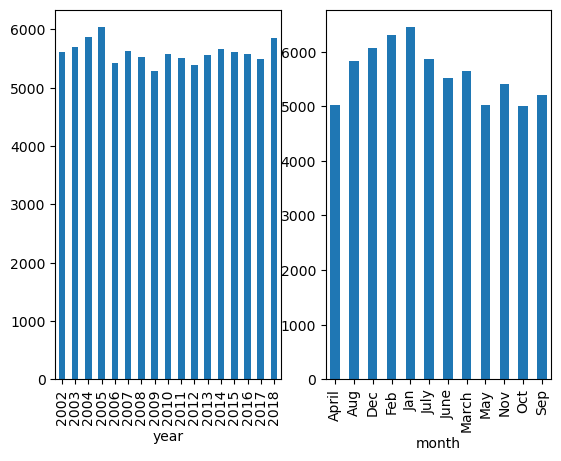

In [29]:
plt.subplot(1,2,1)
df.groupby('year')['PJMW_MW'].mean().plot.bar()
plt.subplot(1,2,2)
df.groupby('month')['PJMW_MW'].mean().plot.bar()


In [30]:
df.head()

,PJMW_MW,Date,year,month,hour,name_of_week,season
Datetime,,,,,,,
2002-12-31 01:00:00,5077,2002-12-31,2002,Dec,1,1,Winter
2002-12-31 02:00:00,4939,2002-12-31,2002,Dec,2,1,Winter
2002-12-31 03:00:00,4885,2002-12-31,2002,Dec,3,1,Winter
2002-12-31 04:00:00,4857,2002-12-31,2002,Dec,4,1,Winter
2002-12-31 05:00:00,4930,2002-12-31,2002,Dec,5,1,Winter


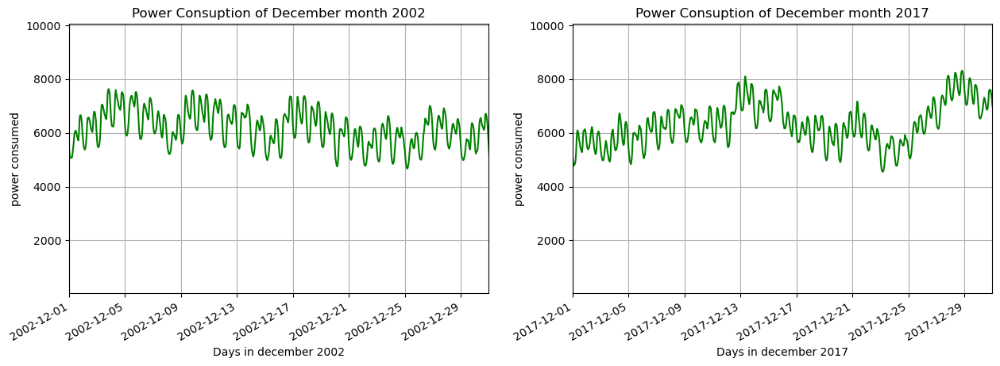

In [31]:
#lets see the plots of days in dec month 2002 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of December month 2002',figsize=(15,5),xlim=['2002-12-01','2002-12-31'],c='green',ylabel='power consumed',xlabel='Days in december 2002',grid=True);
#lets see the plots of days in dec month 2018 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of December month 2017',figsize=(15,5),xlim=['2017-12-01','2017-12-31'],c='green',ylabel='power consumed',xlabel='Days in december 2017',grid=True);


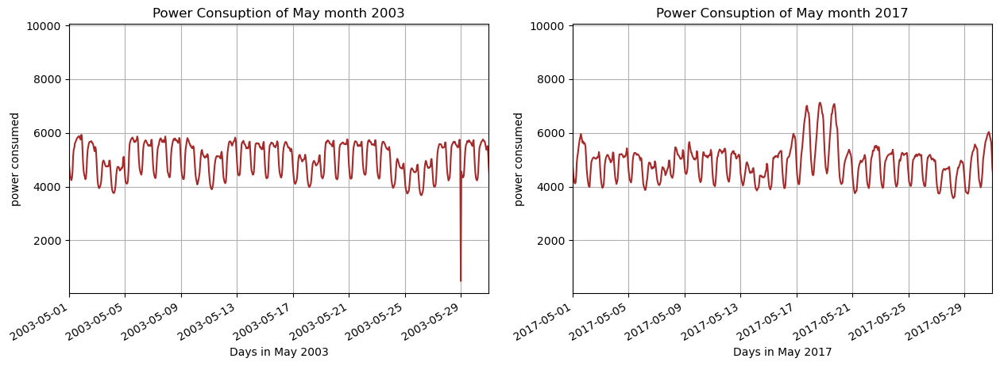

In [32]:
#lets see the plots of days in may month 2002 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of May month 2003',figsize=(15,5),xlim=['2003-05-01','2003-05-31'],c='brown',ylabel='power consumed',xlabel='Days in May 2003',grid=True);
#lets see the plots of days in may month 2018 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of May month 2017',figsize=(15,5),xlim=['2017-05-01','2017-05-31'],c='brown',ylabel='power consumed',xlabel='Days in May 2017',grid=True);


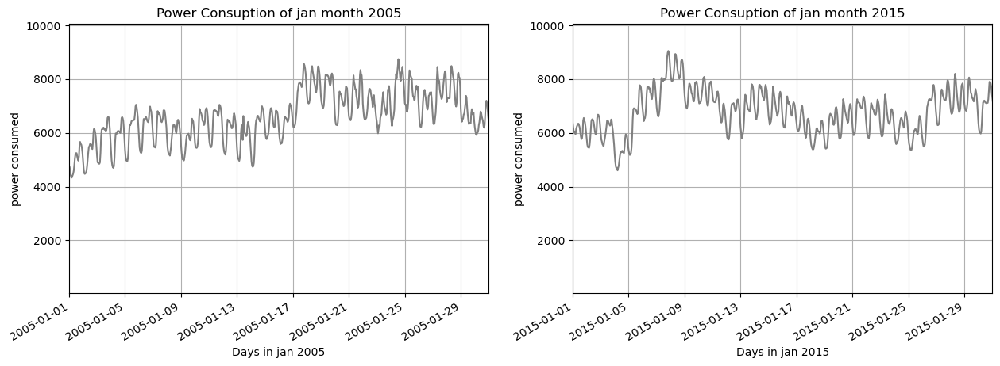

In [33]:
#lets see the plots of days in jan month 2005 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of jan month 2005',figsize=(15,5),xlim=['2005-01-01','2005-01-31'],c='grey',ylabel='power consumed',xlabel='Days in jan 2005',grid=True);
#lets see the plots of days in jan month 2015 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of jan month 2015',figsize=(15,5),xlim=['2015-01-01','2015-01-31'],c='grey',ylabel='power consumed',xlabel='Days in jan 2015',grid=True);


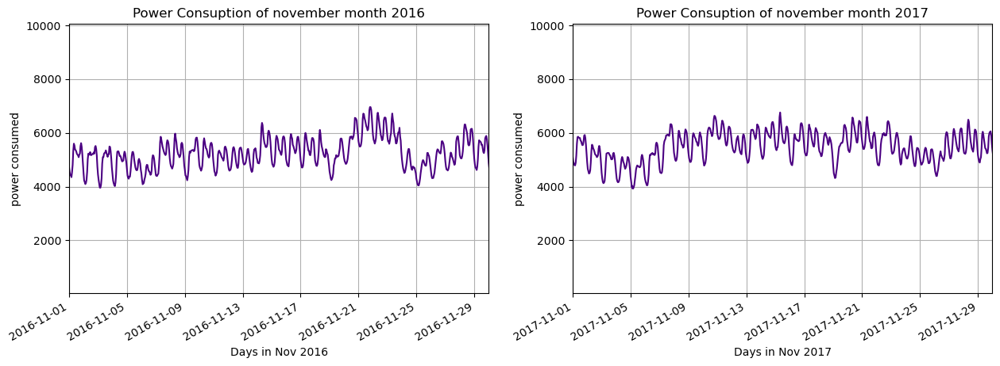

In [34]:
#lets see the plots of days in nov month 2016 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of november month 2016',figsize=(15,5),xlim=['2016-11-01','2016-11-30'],c='indigo',ylabel='power consumed',xlabel='Days in Nov 2016',grid=True);
#lets see the plots of days in nov month 2017 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of november month 2017',figsize=(15,5),xlim=['2017-11-01','2017-11-30'],c='indigo',ylabel='power consumed',xlabel='Days in Nov 2017',grid=True);


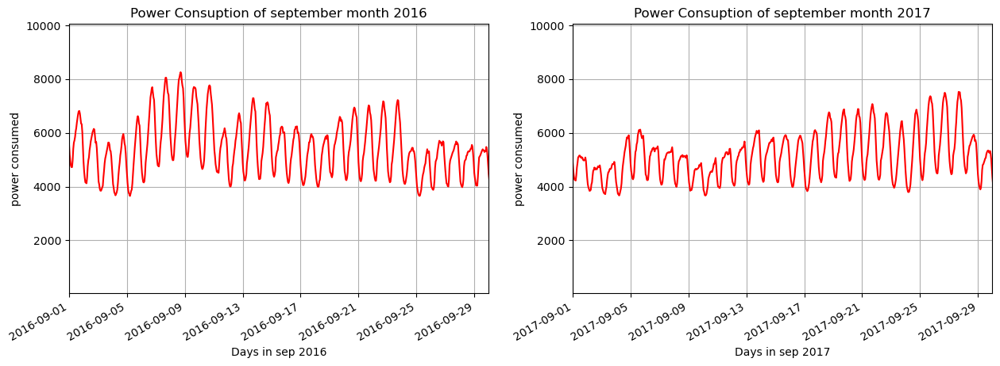

In [35]:
#lets see the plots of days in sep month 2016 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of september month 2016',figsize=(15,5),xlim=['2016-09-01','2016-09-30'],c='red',ylabel='power consumed',xlabel='Days in sep 2016',grid=True);
#lets see the plots of days in sep month 2017 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of september month 2017',figsize=(15,5),xlim=['2017-09-01','2017-09-30'],c='red',ylabel='power consumed',xlabel='Days in sep 2017',grid=True);


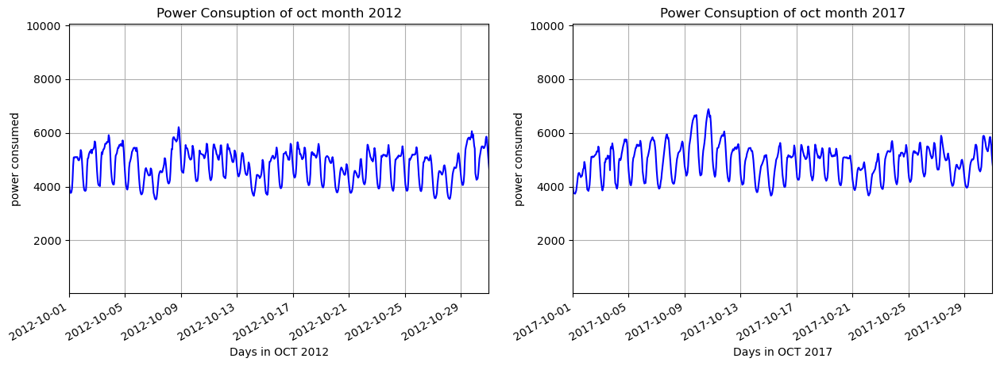

In [36]:
#lets see the plots of days in oct month 2012 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption of oct month 2012',figsize=(15,5),xlim=['2012-10-01','2012-10-31'],c='blue',ylabel='power consumed',xlabel='Days in OCT 2012',grid=True);
#lets see the plots of days in sep month 2017 
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption of oct month 2017',figsize=(15,5),xlim=['2017-10-01','2017-10-31'],c='blue',ylabel='power consumed',xlabel='Days in OCT 2017',grid=True);


# Sesaonal plots

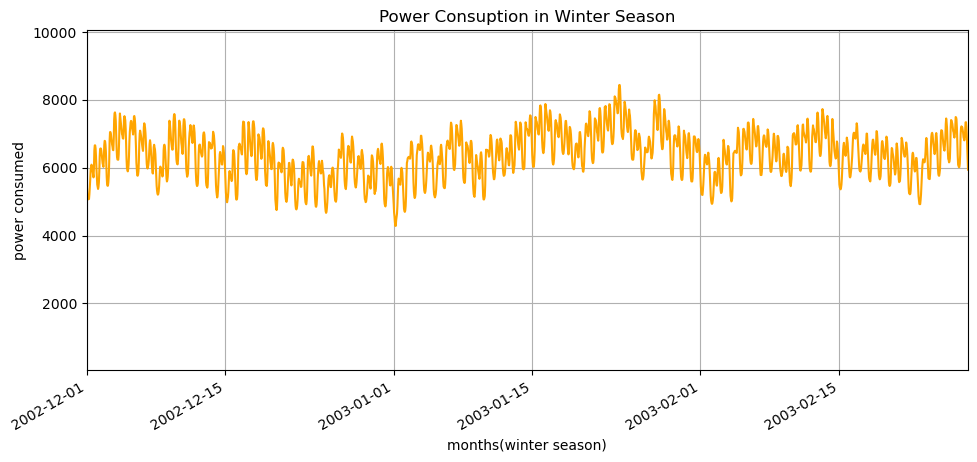

In [37]:
#polting power consption in winter season in the year 2002 
plt.subplot(1,2,1)
df['PJMW_MW'].plot(title='Power Consuption in Winter Season',figsize=(25,5),xlim=['2002-12-01','2003-02-28'],c='orange',ylabel='power consumed',xlabel='months(winter season)',grid=True);


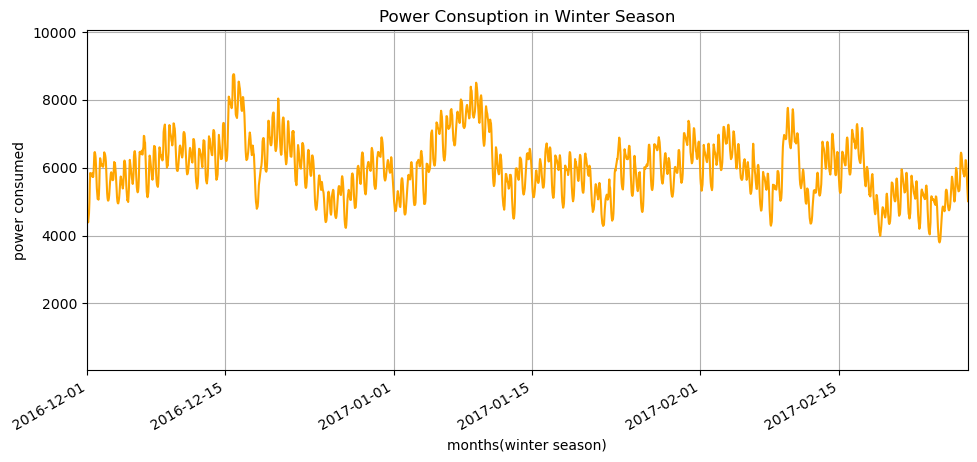

In [38]:
#polting the power consption in winter season the year 2017
plt.subplot(1,2,2)
df['PJMW_MW'].plot(title='Power Consuption in Winter Season',figsize=(25,5),xlim=['2016-12-01','2017-02-28'],c='orange',ylabel='power consumed',xlabel='months(winter season)',grid=True);

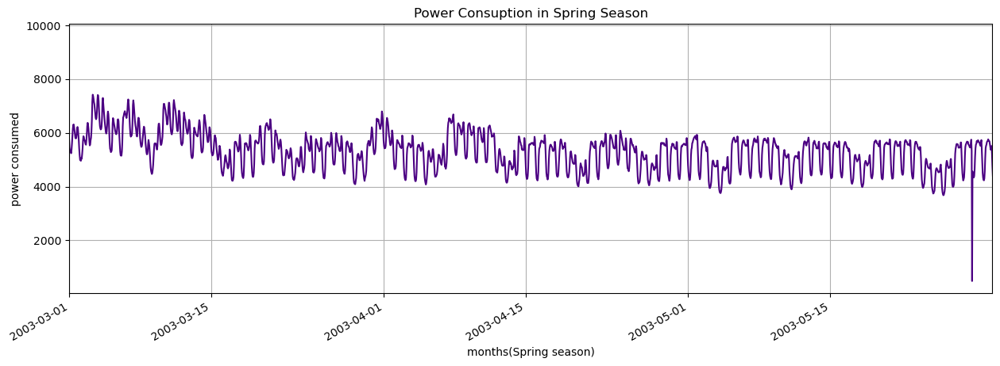

In [39]:
#polting the power consption in Spring season the year 2003

df['PJMW_MW'].plot(title='Power Consuption in Spring Season',figsize=(15,5),xlim=['2003-03-01','2003-05-31'],c='indigo',ylabel='power consumed',xlabel='months(Spring season)',grid=True);

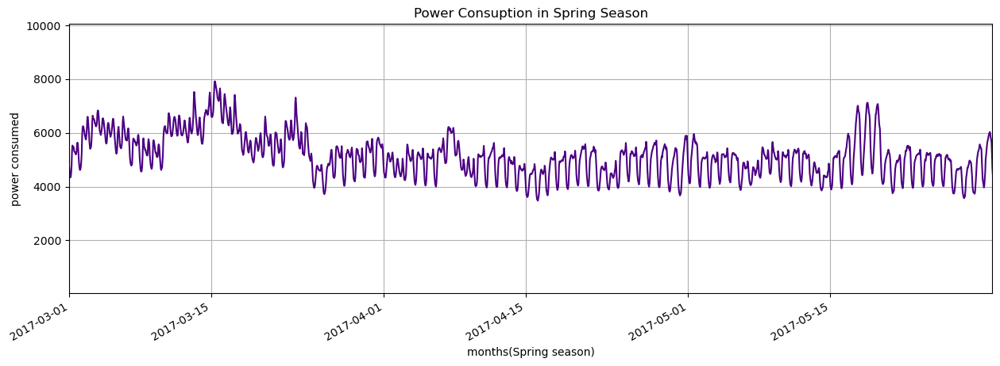

In [40]:
#polting the power consption in Spring season the year 2017
df['PJMW_MW'].plot(title='Power Consuption in Spring Season',figsize=(15,5),xlim=['2017-03-01','2017-05-31'],c='indigo',ylabel='power consumed',xlabel='months(Spring season)',grid=True);

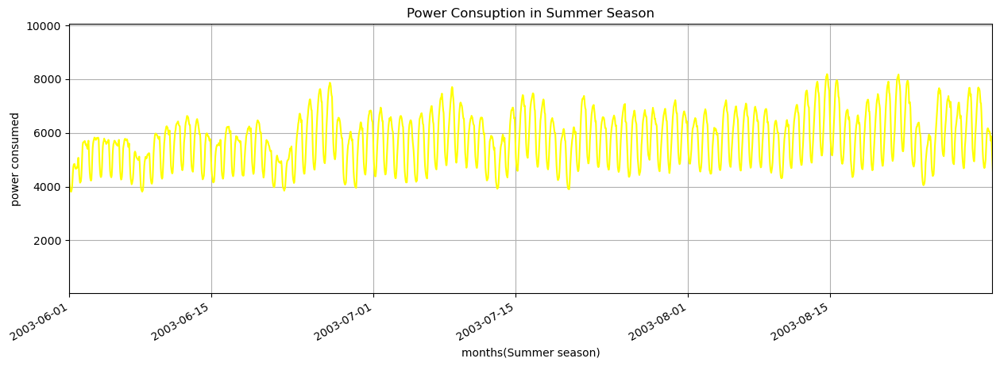

In [41]:
#polting the power consption in Summer season the year 2003
df['PJMW_MW'].plot(title='Power Consuption in Summer Season',figsize=(15,5),xlim=['2003-06-01','2003-08-31'],c='yellow',ylabel='power consumed',xlabel='months(Summer season)',grid=True);

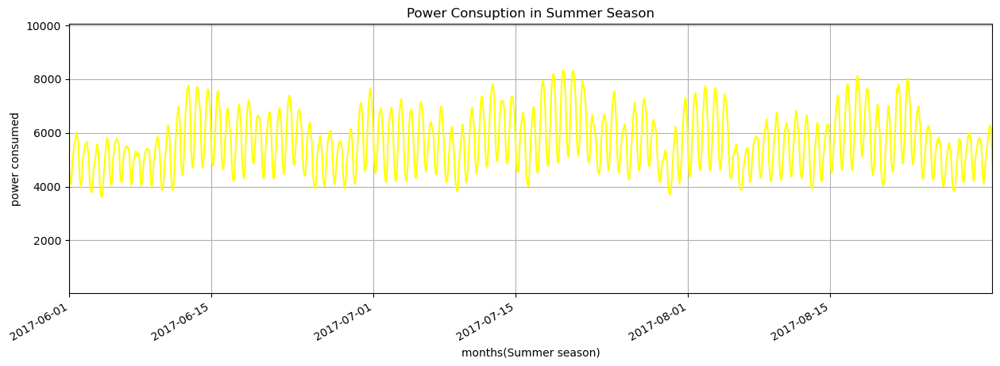

In [42]:
#polting the power consption in Summer season the year 2017
df['PJMW_MW'].plot(title='Power Consuption in Summer Season',figsize=(15,5),xlim=['2017-06-01','2017-08-31'],c='yellow',ylabel='power consumed',xlabel='months(Summer season)',grid=True);

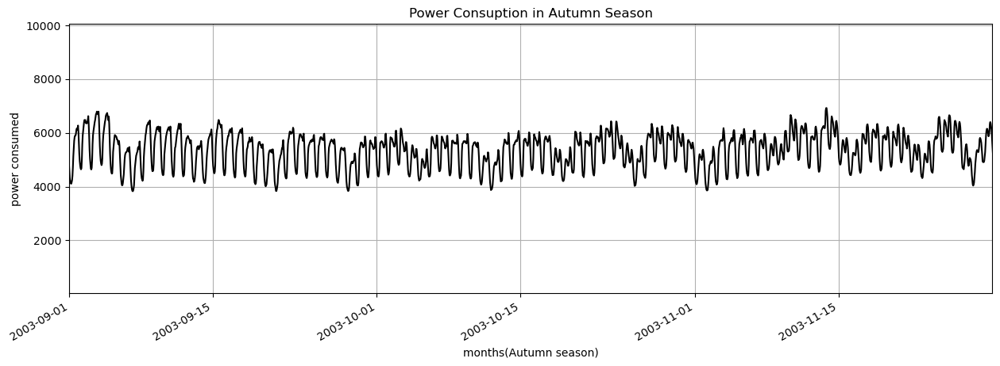

In [43]:
#polting the power consption in Summer season the year 2003
df['PJMW_MW'].plot(title='Power Consuption in Autumn Season',figsize=(15,5),xlim=['2003-09-01','2003-11-30'],c='black',ylabel='power consumed',xlabel='months(Autumn season)',grid=True);

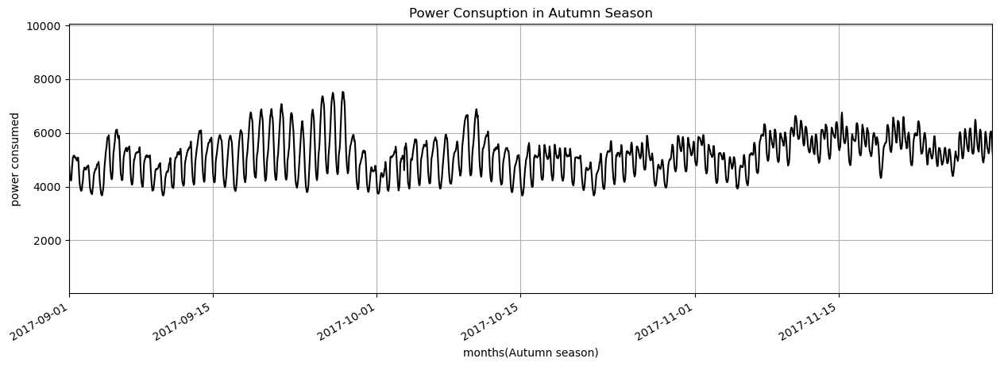

In [44]:
#polting the power consption in Summer season the year 2017
df['PJMW_MW'].plot(title='Power Consuption in Autumn Season',figsize=(15,5),xlim=['2017-09-01','2017-11-30'],c='black',ylabel='power consumed',xlabel='months(Autumn season)',grid=True);

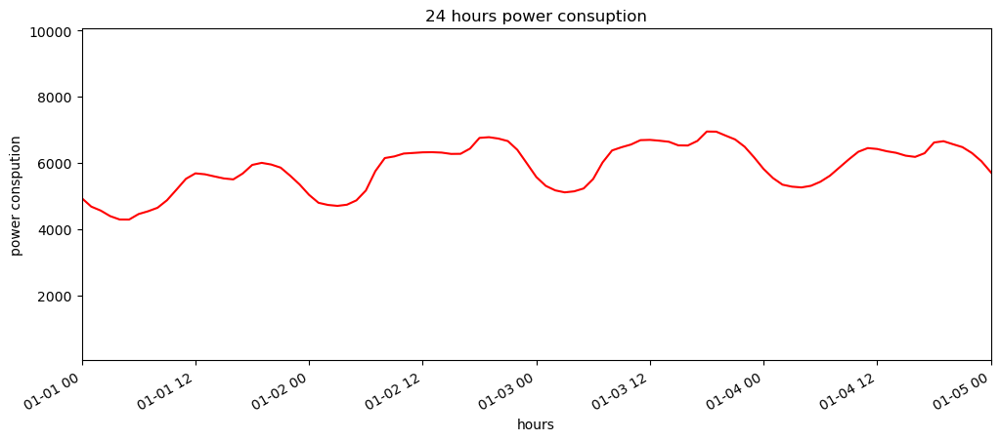

In [45]:
#one day power consumption (24hrs )
df['PJMW_MW'].plot(figsize=(12,5),xlim=['2003-01-01','2003-01-05'],c='red',title='24 hours power consuption',xlabel='hours',ylabel='power conspution');

In [46]:
import plotly.express as px

In [47]:
df=df.reset_index()

In [48]:
fig=px.line(df,x='Datetime',y='PJMW_MW',title='power consuption details over a period from 2002 to 2018')
fig.update_xaxes(rangeslider_visible=True,rangeselector=dict(buttons=list([dict(count=1,label='one year',step='year',stepmode='backward')
                                                                          ,dict(count=2,label='two year',step='year',stepmode='backward'),
                                                                          dict(count=3,label='three year',step='year',stepmode='backward'),dict(step='all')])))
fig.show()

In [49]:
fig=px.histogram(df,x='Datetime',y='PJMW_MW',title='power consuption details over a period from 2002 to 2018')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [50]:
df=df.set_index('Datetime')

In [51]:
plt.figure(figsize=(15,5))
ad_2005=df[df['year']==2005]
ad_2010=df[df['year']==2010]
ad_2015=df[df['year']==2015]

fig1=px.line(ad_2005['PJMW_MW'])
fig1.update_xaxes(rangeslider_visible=True)

fig2=px.line(ad_2010['PJMW_MW'])
fig2.update_xaxes(rangeslider_visible=True)

fig3=px.line(ad_2015['PJMW_MW'])
fig3.update_xaxes(rangeslider_visible=True)
fig1.show()
fig2.show()
fig3.show()


<Figure size 1500x500 with 0 Axes>

Text(0.5, 1.0, 'power conspution of three different years 2005 and 2006 data')

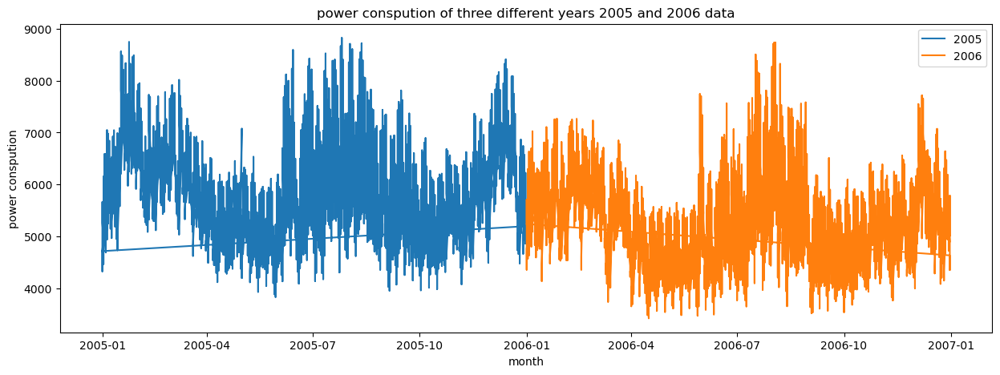

In [52]:
plt.figure(figsize=(15,5))
ad_2005=df[df['year']==2005]
ad_2006=df[df['year']==2006]

plt.plot(ad_2005['Date'],ad_2005['PJMW_MW'])
plt.plot(ad_2006['Date'],ad_2006['PJMW_MW'])

plt.legend(['2005','2006'])
plt.xlabel('month')
plt.ylabel('power conspution')
plt.title('power conspution of three different years 2005 and 2006 data')


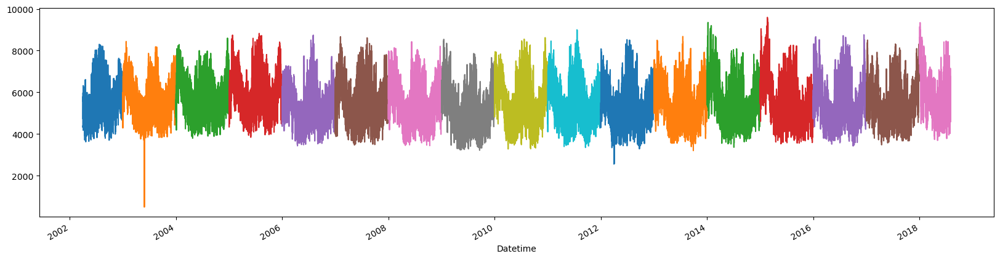

In [53]:
plt.tight_layout()
df['PJMW_MW'].resample(rule='A').plot(figsize=(20,5));

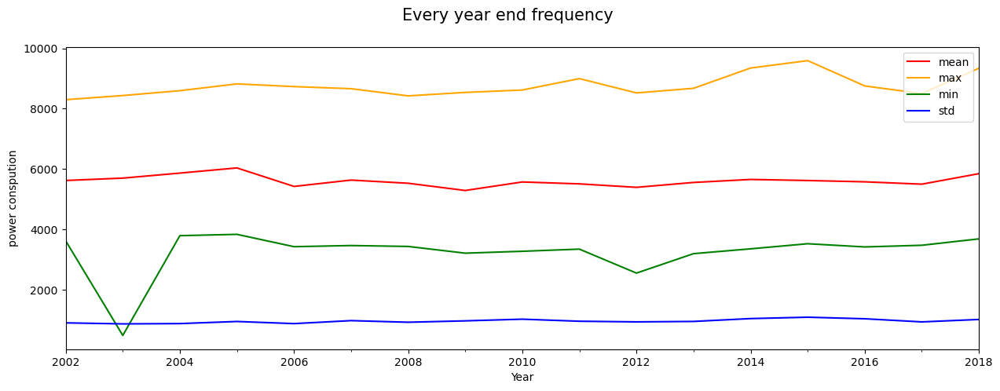

In [54]:
#year end frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='A').mean().plot(c='red')
df['PJMW_MW'].resample(rule='A').max().plot(c='orange')
df['PJMW_MW'].resample(rule='A').min().plot(c='green')
df['PJMW_MW'].resample(rule='A').std().plot(c='blue')

plt.suptitle('Every year end frequency',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')
plt.legend(['mean','max','min','std'])

Text(0, 0.5, 'power conspution')

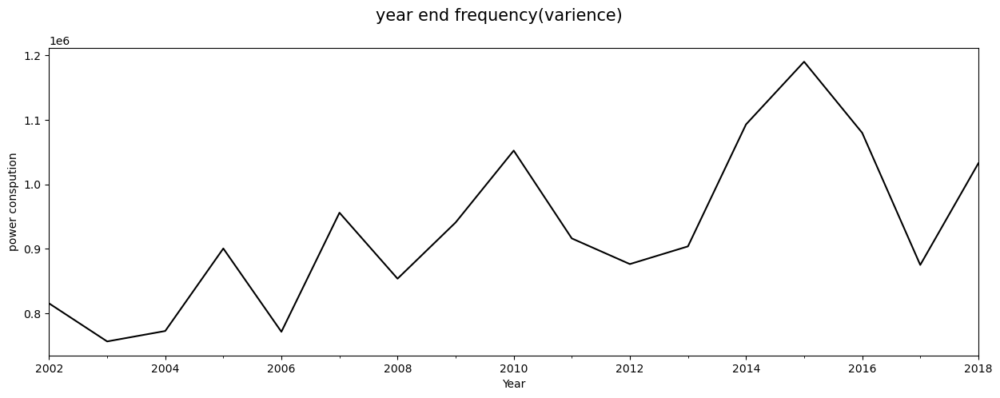

In [55]:
#year end frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='A').var().plot(c='black')

plt.suptitle('year end frequency(varience)',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')

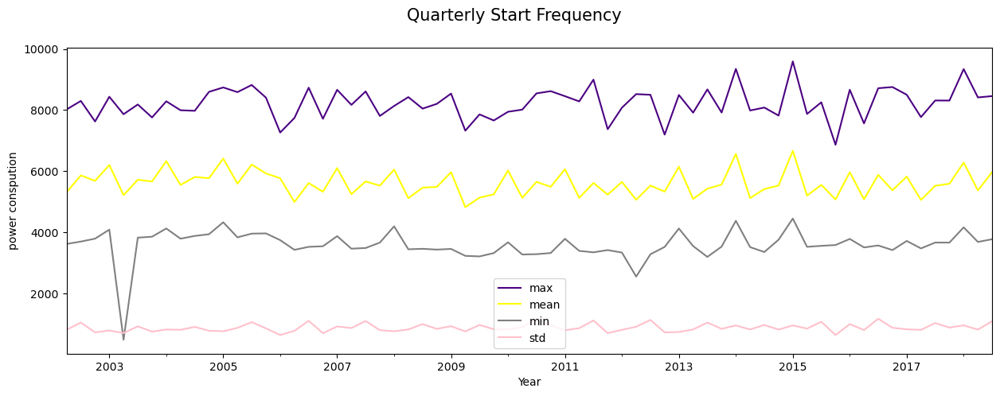

In [56]:
#quaterly start frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='QS').max().plot(c='indigo')
df['PJMW_MW'].resample(rule='QS').mean().plot(c='yellow')
df['PJMW_MW'].resample(rule='QS').min().plot(c='grey')
df['PJMW_MW'].resample(rule='QS').std().plot(c='pink')

plt.suptitle('Quarterly Start Frequency',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')
plt.legend(['max','mean','min','std'])

Text(0, 0.5, 'power conspution')

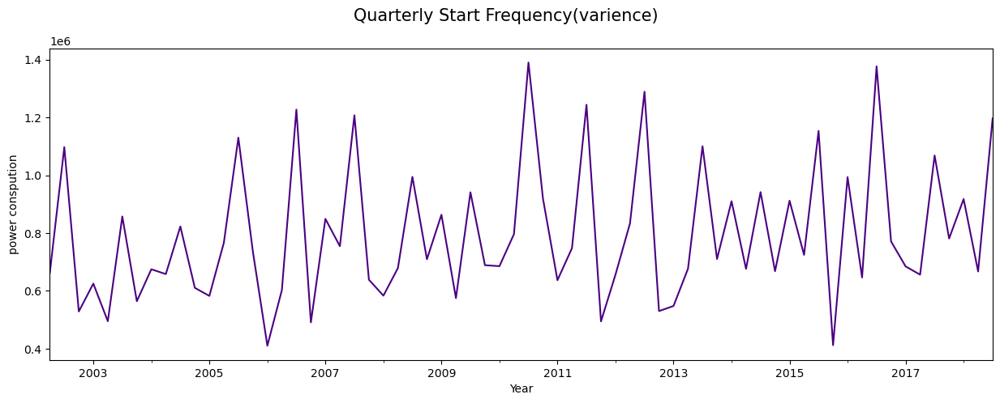

In [57]:
#quaterly start frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='QS').var().plot(c='indigo')
plt.suptitle('Quarterly Start Frequency(varience)',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')

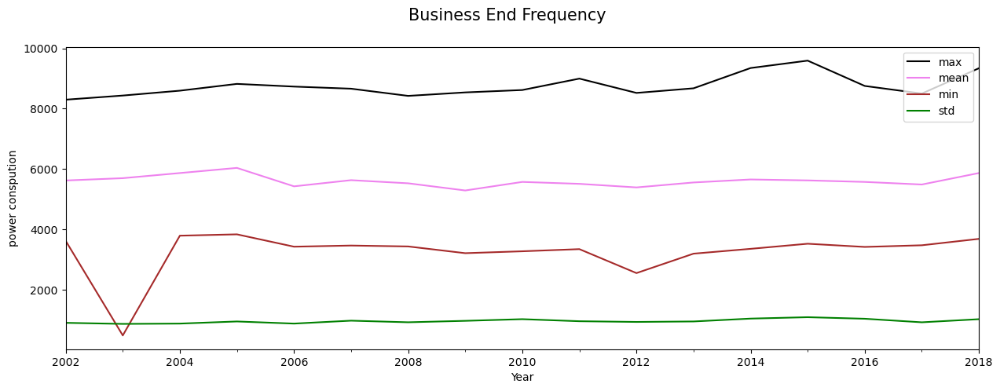

In [58]:
##Business End Frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='BA').max().plot(c='black')
df['PJMW_MW'].resample(rule='BA').mean().plot(c='violet')
df['PJMW_MW'].resample(rule='BA').min().plot(c='brown')
df['PJMW_MW'].resample(rule='BA').std().plot(c='green')


plt.suptitle('Business End Frequency',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')
plt.legend(['max','mean','min','std','var'])

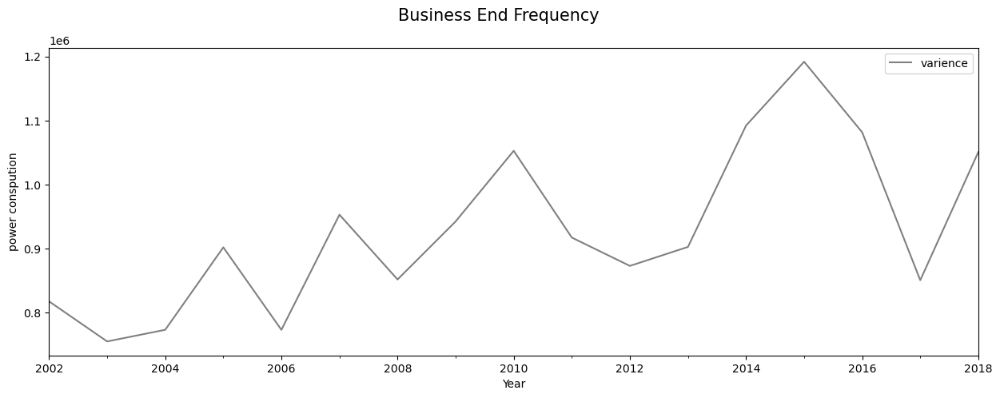

In [59]:
##Business End Frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='BA').var().plot(c='grey')

plt.suptitle('Business End Frequency',fontsize=15)
plt.xlabel('Year')
plt.ylabel('power conspution')
plt.legend(['varience'])

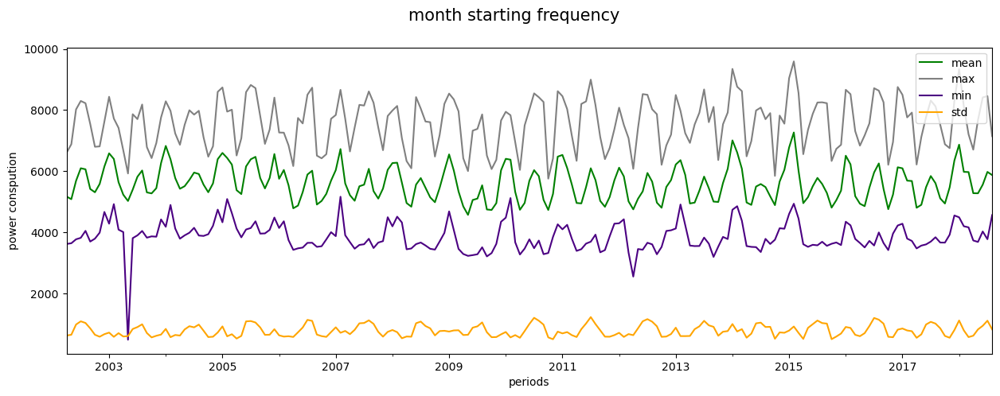

In [60]:
#month starting date frequency
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='MS').mean().plot(c='green')
df['PJMW_MW'].resample(rule='MS').max().plot(c='grey')
df['PJMW_MW'].resample(rule='MS').min().plot(c='indigo')
df['PJMW_MW'].resample(rule='MS').std().plot(c='orange')

plt.suptitle('month starting frequency',fontsize=15)
plt.xlabel('periods')
plt.ylabel('power conspution')
plt.legend(['mean','max','min','std'])

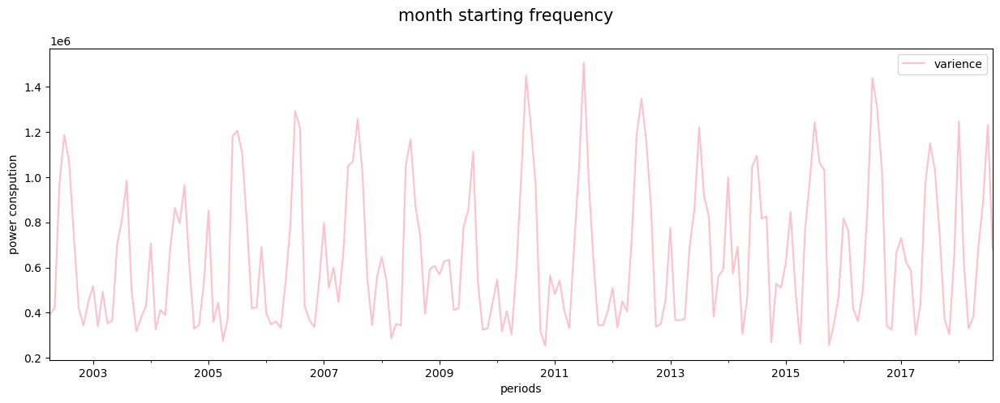

In [61]:
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='MS').var().plot(c='pink')
plt.suptitle('month starting frequency',fontsize=15)
plt.xlabel('periods')
plt.ylabel('power conspution')
plt.legend(['varience'])

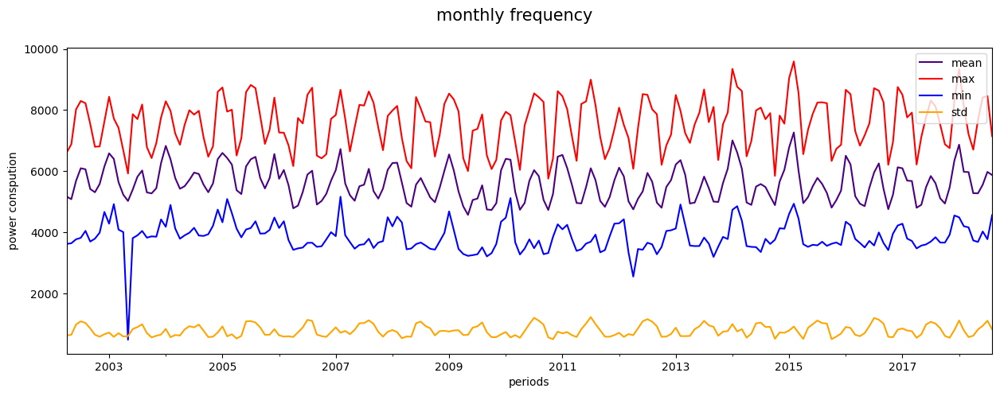

In [62]:
#Monthly frequency of the data
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='M').mean().plot(c='indigo')
df['PJMW_MW'].resample(rule='M').max().plot(c='red')
df['PJMW_MW'].resample(rule='M').min().plot(c='blue')
df['PJMW_MW'].resample(rule='M').std().plot(c='orange')

plt.suptitle('monthly frequency',fontsize=15)
plt.xlabel('periods')
plt.ylabel('power conspution')
plt.legend(['mean','max','min','std'])

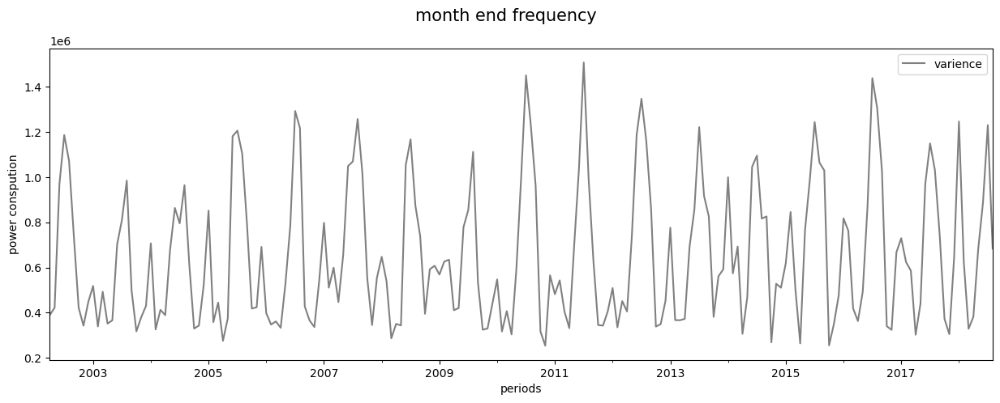

In [63]:
plt.figure(figsize=(15,5))
df['PJMW_MW'].resample(rule='M').var().plot(c='grey')
plt.suptitle('month end frequency',fontsize=15)
plt.xlabel('periods')
plt.ylabel('power conspution')
plt.legend(['varience'])

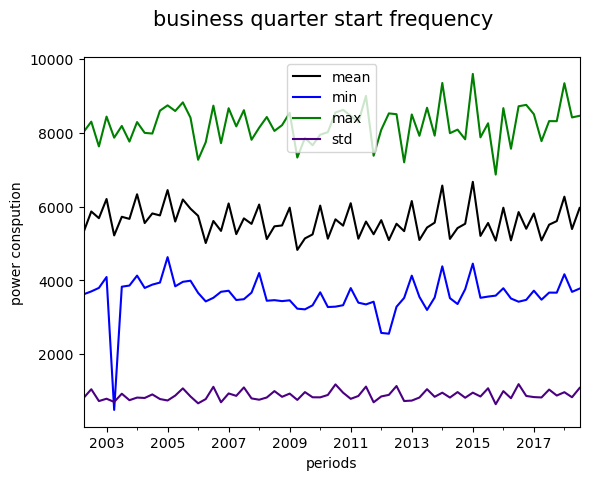

In [64]:
#business quarter start frequency
df['PJMW_MW'].resample(rule='BQS').mean().plot(c='black')
df['PJMW_MW'].resample(rule='BQS').min().plot(c='blue')
df['PJMW_MW'].resample(rule='BQS').max().plot(c='green')
df['PJMW_MW'].resample(rule='BQS').std().plot(c='indigo')

plt.suptitle('business quarter start frequency',fontsize=15)
plt.xlabel('periods')
plt.ylabel('power conspution')
plt.legend(['mean','min','max','std'])

<AxesSubplot:xlabel='Datetime'>

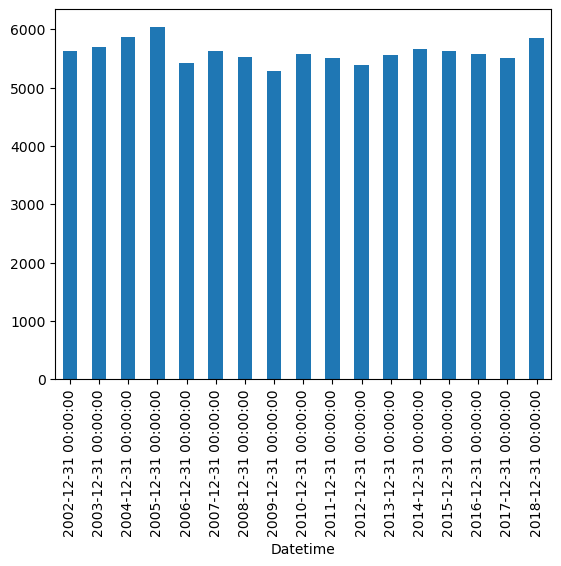

In [65]:
#bar plot on year end data
df['PJMW_MW'].resample(rule='A').mean().plot(kind='bar')

In [66]:
new_df=df
new_df['10 days rolling mean']=new_df['PJMW_MW'].rolling(10).mean()
new_df['10 days rolling std']=new_df['PJMW_MW'].rolling(10).std()

In [67]:
new_df.head(15)

,PJMW_MW,Date,year,month,hour,name_of_week,season,10 days rolling mean,10 days rolling std
Datetime,,,,,,,,,
2002-12-31 01:00:00,5077,2002-12-31,2002,Dec,1,1,Winter,NaN,NaN
2002-12-31 02:00:00,4939,2002-12-31,2002,Dec,2,1,Winter,NaN,NaN
2002-12-31 03:00:00,4885,2002-12-31,2002,Dec,3,1,Winter,NaN,NaN
2002-12-31 04:00:00,4857,2002-12-31,2002,Dec,4,1,Winter,NaN,NaN
2002-12-31 05:00:00,4930,2002-12-31,2002,Dec,5,1,Winter,NaN,NaN
2002-12-31 06:00:00,5126,2002-12-31,2002,Dec,6,1,Winter,NaN,NaN
2002-12-31 07:00:00,5493,2002-12-31,2002,Dec,7,1,Winter,NaN,NaN
2002-12-31 08:00:00,5824,2002-12-31,2002,Dec,8,1,Winter,NaN,NaN
2002-12-31 09:00:00,5962,2002-12-31,2002,Dec,9,1,Winter,NaN,NaN


Text(0.5, 0.98, 'Rolling Mean(10 days rolling)')

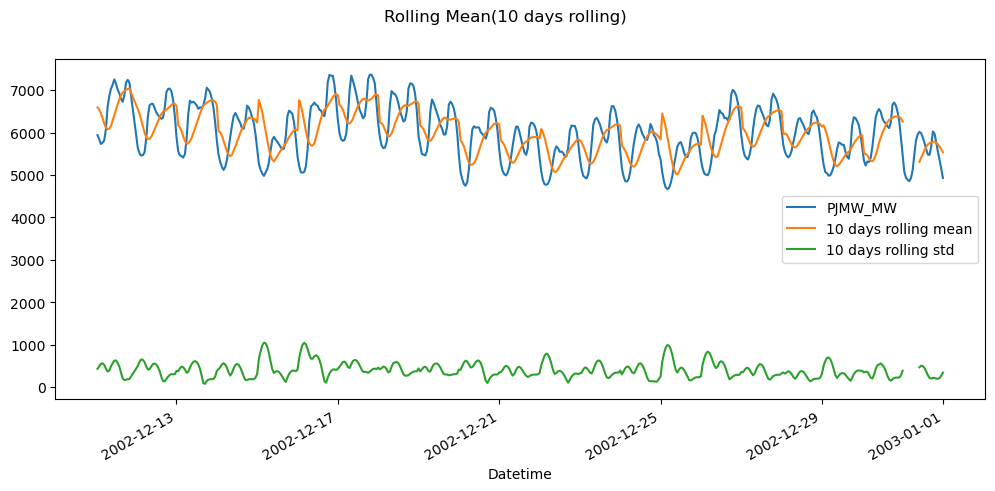

In [68]:
new_df[['PJMW_MW','10 days rolling mean','10 days rolling std']].iloc[0:500].plot(figsize=(12,5))
plt.suptitle('Rolling Mean(10 days rolling)')

In [119]:
df=df.set_index('Datetime')

Text(0.5, 0.98, 'comparing the rolling mean with min,max,std')

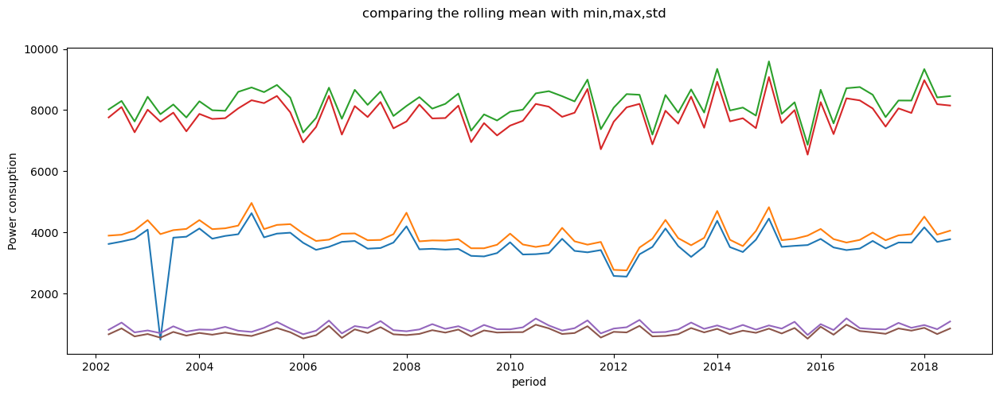

In [70]:
# business quarter start frequency
plt.figure(figsize=(15,5))
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='BQS').min())
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='BQS').max())
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='BQS').std())
plt.xlabel('period')
plt.ylabel('Power consuption')
plt.suptitle('comparing the rolling mean with min,max,std')

Text(0.5, 0.98, 'Month end frequency(applying rolling mean)')

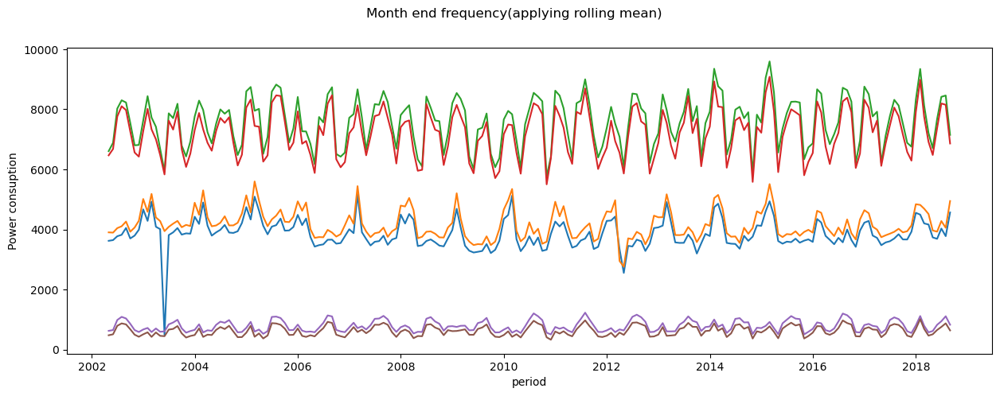

In [71]:
#month end frequency
plt.figure(figsize=(15,5))
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='M').min())
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='M').max())
plt.plot(df[['PJMW_MW','10 days rolling mean']].resample(rule='M').std())
plt.xlabel('period')
plt.ylabel('Power consuption')
plt.suptitle('Month end frequency(applying rolling mean)')

In [72]:
new_df['30 days rolling']=new_df['PJMW_MW'].rolling(30).mean()
new_df['30 days rolling std']=new_df['PJMW_MW'].rolling(30).std()

new_df.head(35)

,PJMW_MW,Date,year,month,hour,name_of_week,season,10 days rolling mean,10 days rolling std,30 days rolling,30 days rolling std
Datetime,,,,,,,,,,,
2002-12-31 01:00:00,5077,2002-12-31,2002,Dec,1,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 02:00:00,4939,2002-12-31,2002,Dec,2,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 03:00:00,4885,2002-12-31,2002,Dec,3,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 04:00:00,4857,2002-12-31,2002,Dec,4,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 05:00:00,4930,2002-12-31,2002,Dec,5,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 06:00:00,5126,2002-12-31,2002,Dec,6,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 07:00:00,5493,2002-12-31,2002,Dec,7,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 08:00:00,5824,2002-12-31,2002,Dec,8,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 09:00:00,5962,2002-12-31,2002,Dec,9,1,Winter,NaN,NaN,NaN,NaN


Text(0.5, 0.98, 'Rolling Mean(30 days rolling)')

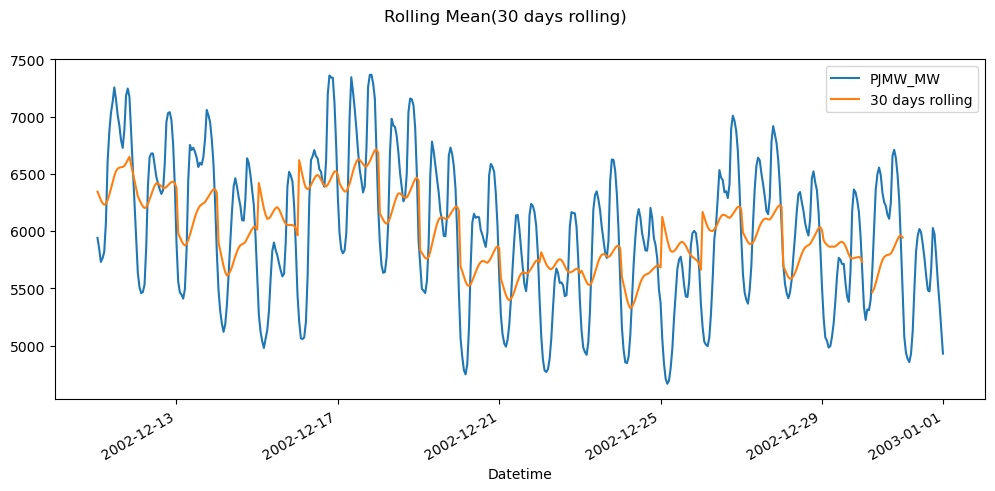

In [73]:
new_df[['PJMW_MW','30 days rolling']].iloc[0:500].plot(figsize=(12,5))
plt.suptitle('Rolling Mean(30 days rolling)')

In [120]:
new_df=new_df.set_index('Datetime')

KeyError: "None of ['Datetime'] are in the columns"

Text(0.5, 0.98, 'Month end frequency(applying rolling mean)')

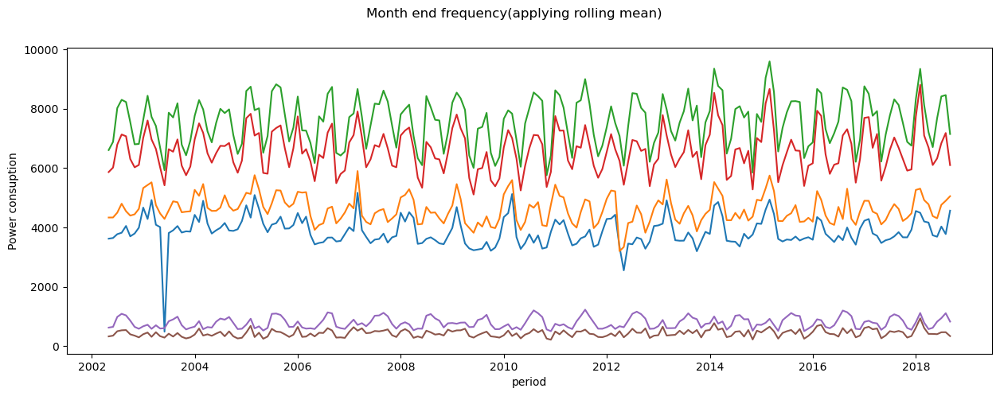

In [75]:
#month end frequency
plt.figure(figsize=(15,5))
plt.plot(new_df[['PJMW_MW','30 days rolling']].resample(rule='M').min())
plt.plot(new_df[['PJMW_MW','30 days rolling']].resample(rule='M').max())
plt.plot(new_df[['PJMW_MW','30 days rolling']].resample(rule='M').std())
plt.xlabel('period')
plt.ylabel('Power consuption')
plt.suptitle('Month end frequency(applying rolling mean)')

In [76]:
df

,PJMW_MW,Date,year,month,hour,name_of_week,season,10 days rolling mean,10 days rolling std,30 days rolling,30 days rolling std
Datetime,,,,,,,,,,,
2002-12-31 01:00:00,5077,2002-12-31,2002,Dec,1,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 02:00:00,4939,2002-12-31,2002,Dec,2,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 03:00:00,4885,2002-12-31,2002,Dec,3,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 04:00:00,4857,2002-12-31,2002,Dec,4,1,Winter,NaN,NaN,NaN,NaN
2002-12-31 05:00:00,4930,2002-12-31,2002,Dec,5,1,Winter,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2018-01-01 20:00:00,8401,2018-01-01,2018,Jan,20,0,Winter,7786.4,374.547193,7828.033333,397.825337
2018-01-01 21:00:00,8373,2018-01-01,2018,Jan,21,0,Winter,7862.3,410.871716,7853.333333,407.755026
2018-01-01 22:00:00,8238,2018-01-01,2018,Jan,22,0,Winter,7933.7,407.576046,7872.833333,411.812150


In [77]:
df=pd.read_excel('PJMW_MW_Hourly.xlsx')
df=df.sort_values('Datetime')
df=df.set_index('Datetime')
df['PJMW_MW']=df['PJMW_MW'].resample('D').mean()
df=df.dropna()

In [78]:
df.head()

,PJMW_MW
Datetime,
2002-04-02,5310.416667
2002-04-03,5325.916667
2002-04-04,5670.791667
2002-04-05,5686.125000
2002-04-06,5367.791667


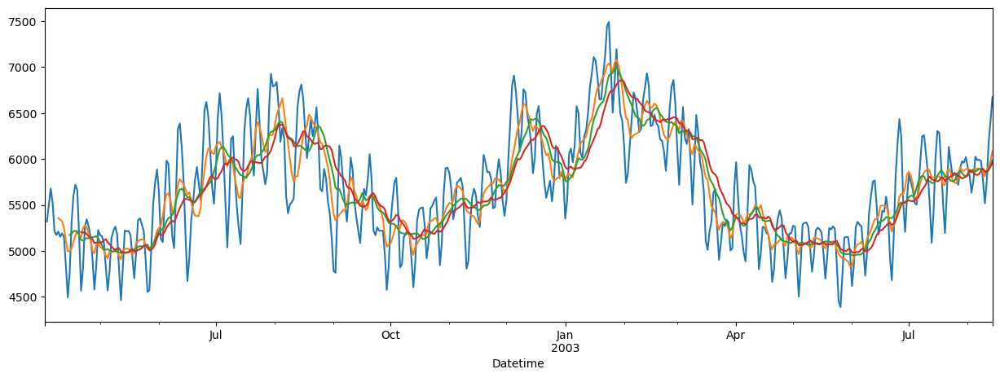

In [79]:
#here i am applying rolling for different number 

plt.figure(figsize=(15,5))

for i in range(2,24,6):
    df['PJMW_MW'].iloc[:500].rolling(i).mean().plot()

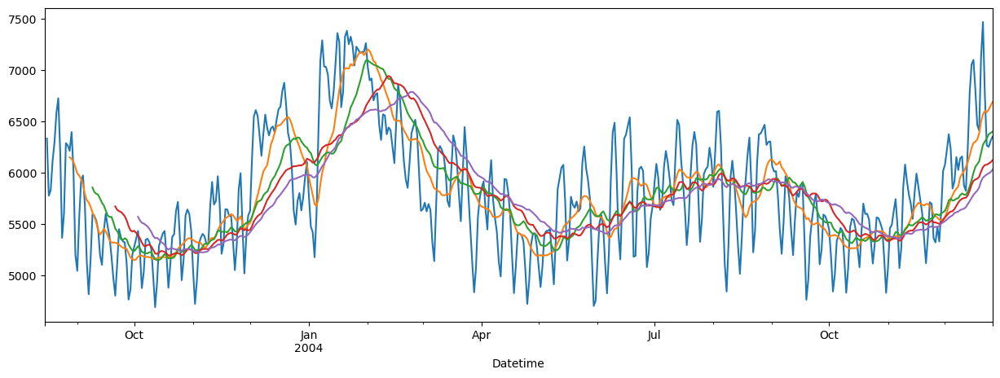

In [80]:
#here i am applying rolling for different number 

plt.figure(figsize=(15,5))
for i in range (2,60,12):
           df['PJMW_MW'].iloc[500:1000].rolling(i).mean().plot()

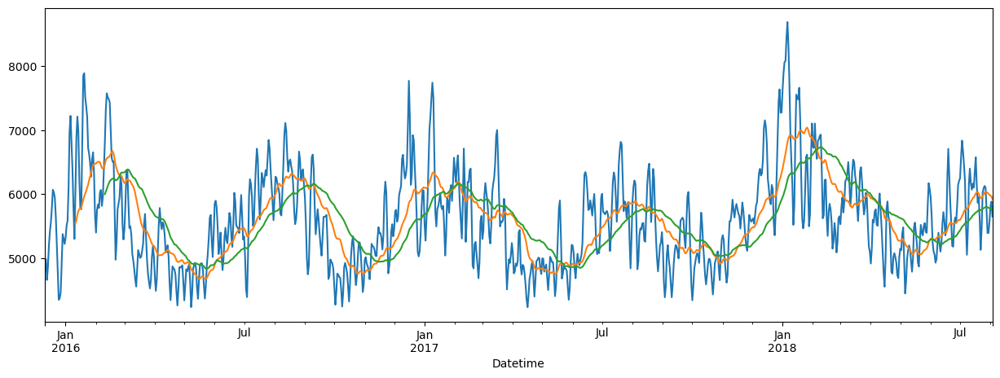

In [81]:
#here i am applying rolling for different number 

plt.figure(figsize=(15,5))
for i in range (2,90,30):
           df['PJMW_MW'].iloc[5000:].rolling(i).mean().plot()

In [82]:
df=pd.read_excel('PJMW_MW_Hourly.xlsx')

# Lag Plots

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 1)'>

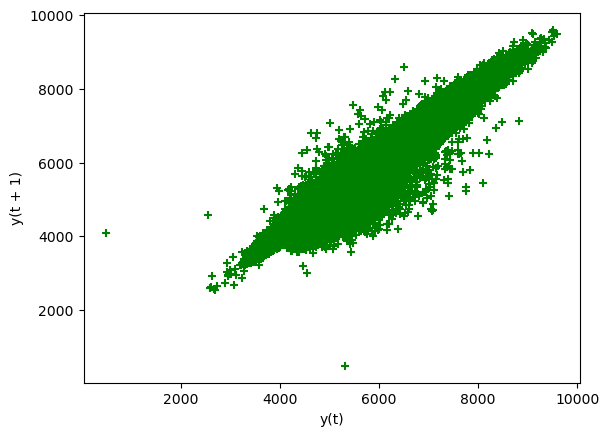

In [83]:
#finding Autocorrelation by using lag plots

from pandas.plotting import lag_plot

lag_plot(df['PJMW_MW'],c='green',marker='+')

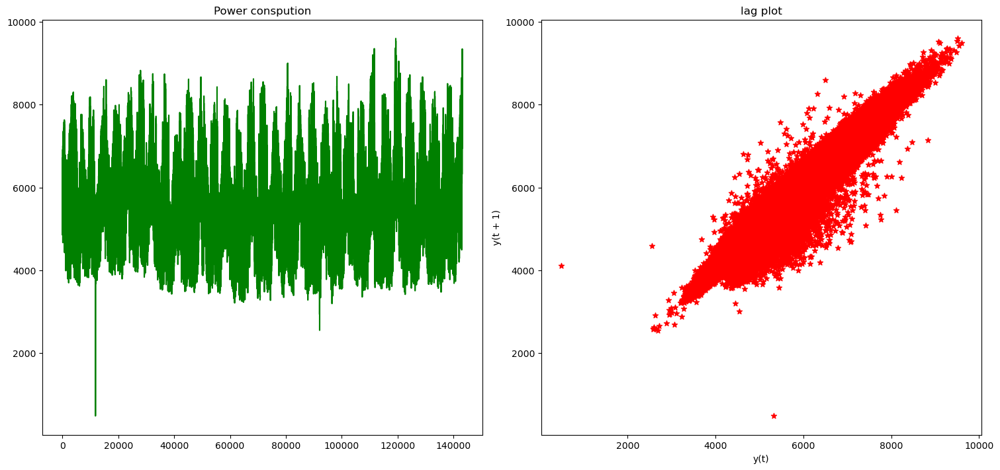

In [84]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7),constrained_layout=True)
ax[0].plot(df['PJMW_MW'],c='green')
ax[0].set_title('Power conspution')
lag_plot(df['PJMW_MW'],lag=1,ax =ax[1],c='red',marker='*')
ax[1].set_title('lag plot')
plt.show()

In [85]:
#the value which is less then 3000 i have made it 3000
df[df['PJMW_MW'] < 3000]['PJMW_MW']=3000

C:\Users\sagar.MANJUNATH\AppData\Local\Temp\ipykernel_3780\1759913633.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# ACF and PACF plots

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



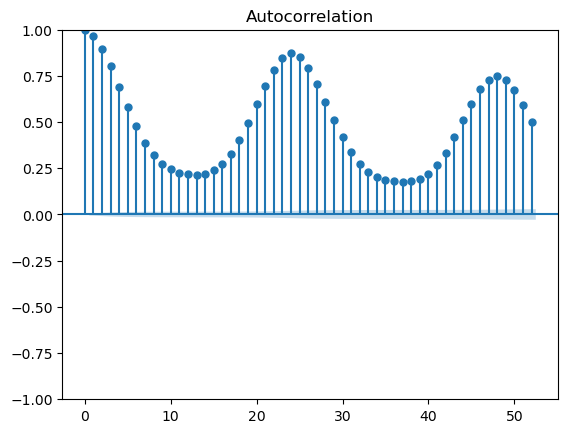

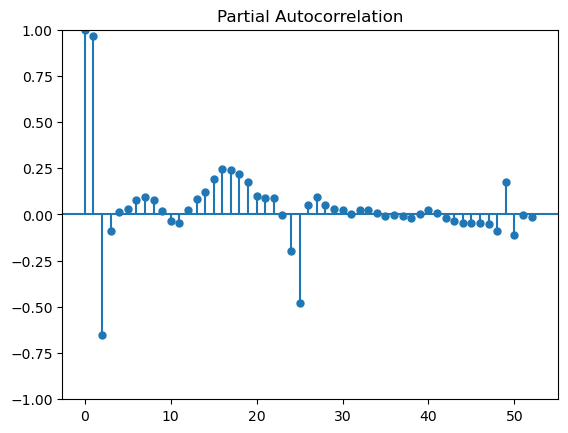

In [86]:
#auto-correlation function which gives us values of auto-correlation of any series with its lagged values
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
plot_acf(df['PJMW_MW'])
#partial auto-correlation function it finds correlation of the residuals
plot_pacf(df['PJMW_MW'])
plt.show()

In [ ]:
#applying rolling mean folding 12 datas
acf = plot_acf(df["PJMW_MW"].rolling(12).mean().dropna())
pacf = plot_pacf(df["PJMW_MW"].rolling(12).mean().dropna())

In [ ]:
#applying rolling mean folding 24 datas
acf = plot_acf(df["PJMW_MW"].rolling(24).mean().dropna())
pacf = plot_pacf(df["PJMW_MW"].rolling(24).mean().dropna())

# Augmented Dickey-Fuller (ADF) Test 

In [ ]:
#checking Stationary
from statsmodels.tsa.stattools import adfuller
def adf_test(timeseries):
    print ('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput)

In [ ]:
adf_test(df['PJMW_MW'])

# Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test

<AxesSubplot:xlabel='Datetime', ylabel='seasonal'>

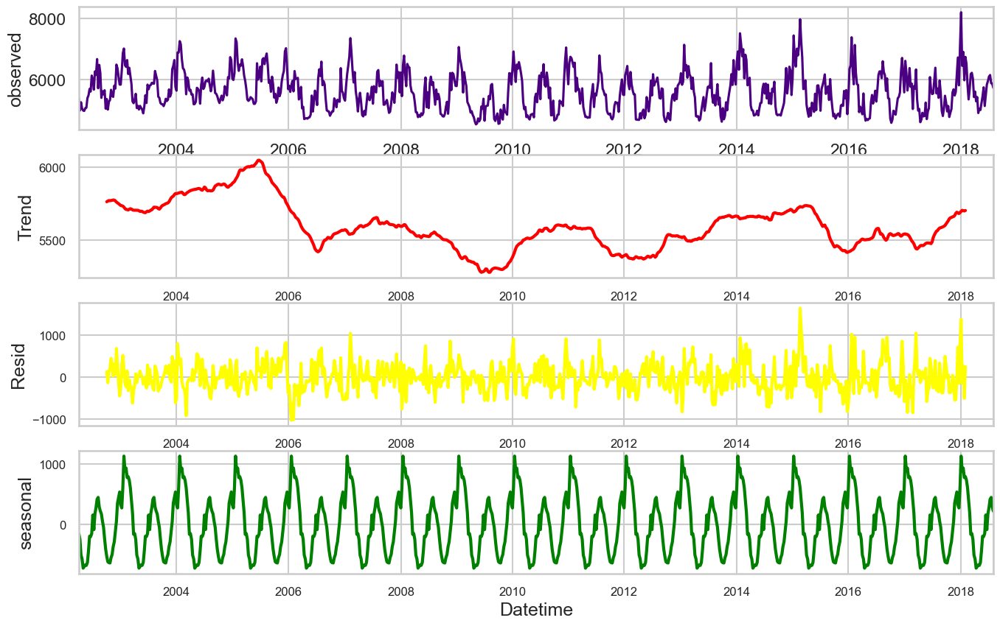

In [87]:
from statsmodels.tsa.seasonal import seasonal_decompose
sns.set_style('whitegrid')
sns.set_context('talk')
res=seasonal_decompose(new_df['PJMW_MW'].resample('W').mean(),model='additive')
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(16,10))
new_df['PJMW_MW'].resample('W').mean().plot(ax=ax1,c='indigo',ylabel='observed')
res.trend.plot(ax=ax2,c='red',lw=3,ylabel='Trend',fontsize=12)
res.resid.plot(ax=ax3,c='yellow',lw=3,ylabel='Resid',fontsize=12)
res.seasonal.plot(ax=ax4,c='green',lw=3,ylabel='seasonal',fontsize=12)

<AxesSubplot:xlabel='Datetime', ylabel='seasonal'>

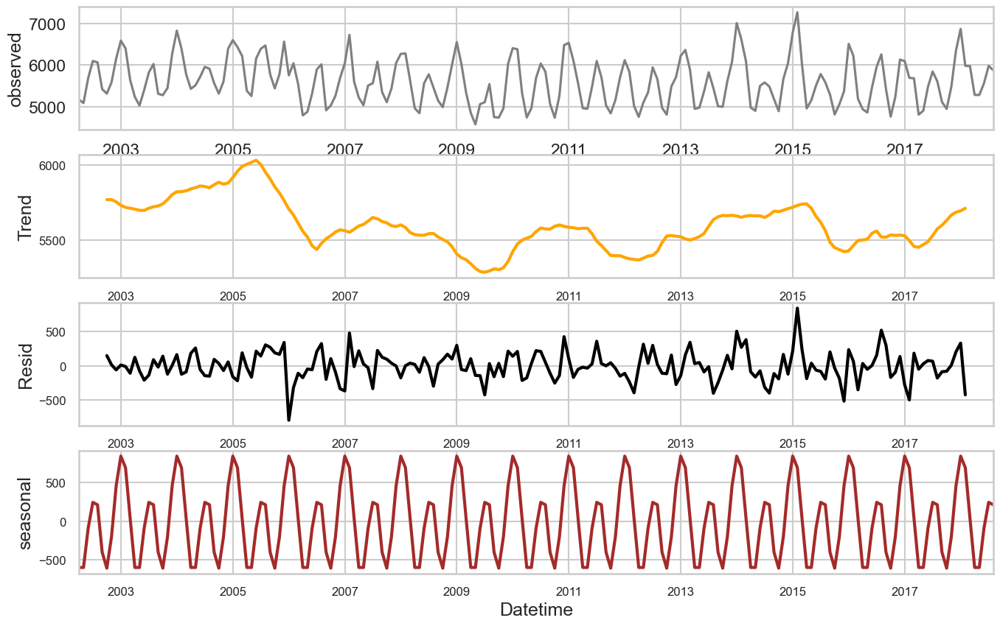

In [88]:
res=seasonal_decompose(new_df['PJMW_MW'].resample('M').mean(),model='additive')
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(16,10))
new_df['PJMW_MW'].resample('M').mean().plot(ax=ax1,c='grey',ylabel='observed')
res.trend.plot(ax=ax2,c='orange',lw=3,ylabel='Trend',fontsize=12)
res.resid.plot(ax=ax3,c='black',lw=3,ylabel='Resid',fontsize=12)
res.seasonal.plot(ax=ax4,c='brown',lw=3,ylabel='seasonal',fontsize=12)

<AxesSubplot:xlabel='Datetime', ylabel='seasonal'>

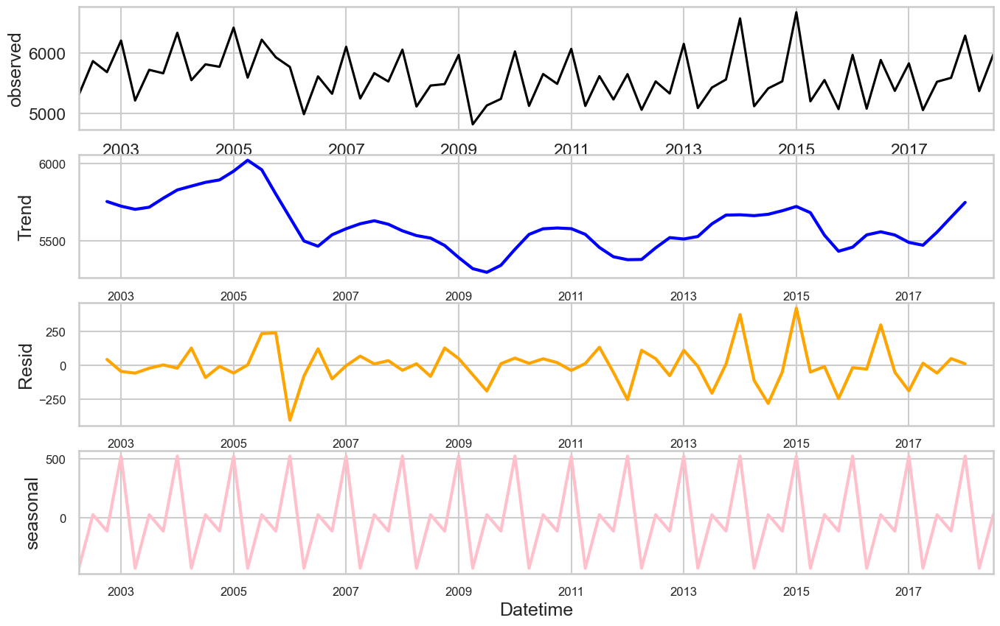

In [89]:
res=seasonal_decompose(new_df['PJMW_MW'].resample('Q').mean(),model='additive')
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(16,10))
new_df['PJMW_MW'].resample('q').mean().plot(ax=ax1,c='black',ylabel='observed')
res.trend.plot(ax=ax2,c='blue',lw=3,ylabel='Trend',fontsize=12)
res.resid.plot(ax=ax3,c='orange',lw=3,ylabel='Resid',fontsize=12)
res.seasonal.plot(ax=ax4,c='pink',lw=3,ylabel='seasonal',fontsize=12)

<AxesSubplot:xlabel='Datetime', ylabel='seasonal'>

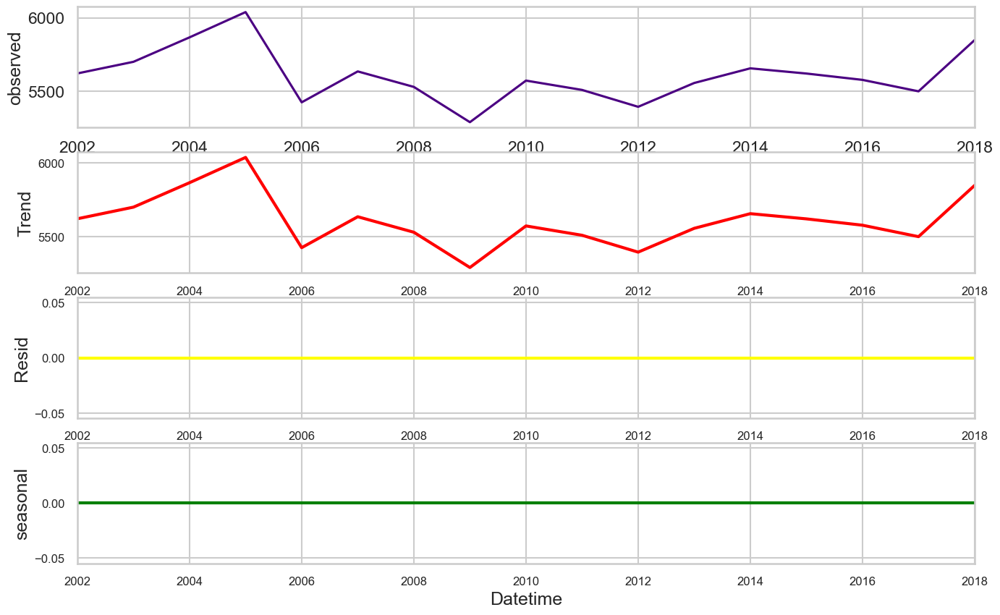

In [90]:
res=seasonal_decompose(new_df['PJMW_MW'].resample('y').mean(),model='additive')
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(16,10))
new_df['PJMW_MW'].resample('y').mean().plot(ax=ax1,c='indigo',ylabel='observed')
res.trend.plot(ax=ax2,c='red',lw=3,ylabel='Trend',fontsize=12)
res.resid.plot(ax=ax3,c='yellow',lw=3,ylabel='Resid',fontsize=12)
res.seasonal.plot(ax=ax4,c='green',lw=3,ylabel='seasonal',fontsize=12)

# KPSS TEST to find Stationarity

In [91]:
from statsmodels.tsa.stattools import kpss

def kpss_test(timeseries):
    print ('Results of KPSS Test:')
    kpsstest = kpss(timeseries, regression='ct', nlags="auto")
    kpss_output = pd.Series(kpsstest[0:3], index=['Test Statistic','p-value','#Lags Used'])
    for key,value in kpsstest[3].items():
        kpss_output['Critical Value (%s)'%key] = value
    print (kpss_output)

In [92]:
kpss_test(df['PJMW_MW'])

Results of KPSS Test:
Test Statistic             0.639772
p-value                    0.010000
#Lags Used               167.000000
Critical Value (10%)       0.119000
Critical Value (5%)        0.146000
Critical Value (2.5%)      0.176000
Critical Value (1%)        0.216000
dtype: float64


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




# P value is less then 5% in KPSS it States that no Stationarity exists

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

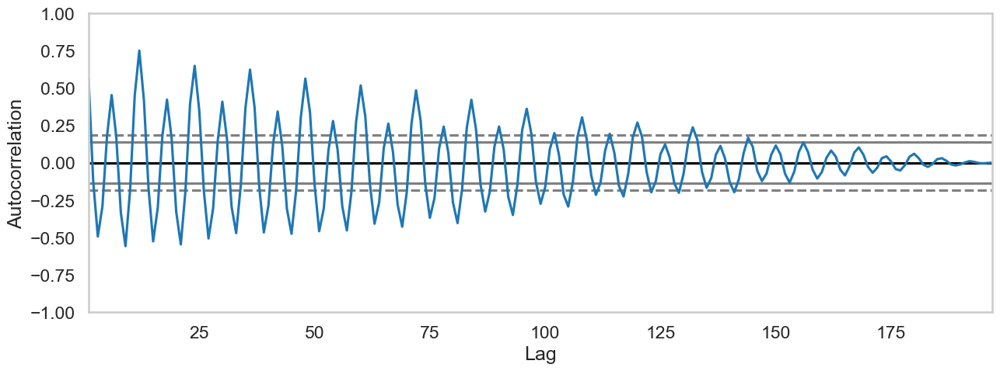

In [219]:
plt.figure(figsize=(15,5))
pd.plotting.autocorrelation_plot(df['PJMW_MW'].resample('1m').mean())

# Checking Kpss test after doing differntion

In [122]:
kpss_test(df['differnce-1'].iloc[1:])

Results of KPSS Test:
Test Statistic              0.007888
p-value                     0.100000
#Lags Used               1669.000000
Critical Value (10%)        0.119000
Critical Value (5%)         0.146000
Critical Value (2.5%)       0.176000
Critical Value (1%)         0.216000
dtype: float64


In [123]:
adf_test(df['differnce-1'].iloc[1:])

NameError: name 'adf_test' is not defined

In [245]:
#from the above step i found that data is not in stationary form

df['differnce-1']=df['PJMW_MW'].diff()

In [246]:
df['differnce-2']=df['PJMW_MW'].diff(2)
df['differnce-3']=df['PJMW_MW'].diff(3)

In [247]:
df.head()

,PJMW_MW,diff1,differnce-1,differnce-2,differnce-3
Datetime,,,,,
2002-04-01 01:00:00,4374,-320.0,NaN,NaN,NaN
2002-04-01 02:00:00,4306,-68.0,-68.0,NaN,NaN
2002-04-01 03:00:00,4322,16.0,16.0,-52.0,NaN
2002-04-01 04:00:00,4359,37.0,37.0,53.0,-15.0
2002-04-01 05:00:00,4436,77.0,77.0,114.0,130.0


In [248]:
df=df.sort_values('Datetime')

<AxesSubplot:xlabel='Datetime'>

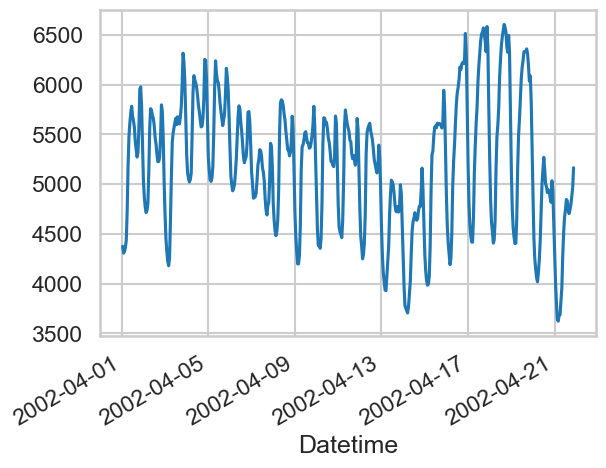

In [249]:
df['PJMW_MW'].iloc[:500].plot()

<AxesSubplot:xlabel='Datetime'>

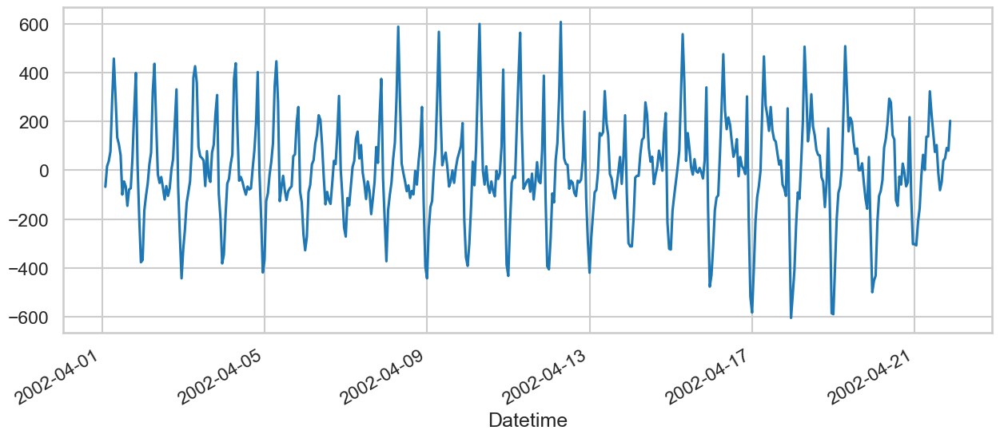

In [250]:
plt.figure(figsize=(15,6))

df['differnce-1'].iloc[:500].plot()


<AxesSubplot:xlabel='Datetime'>

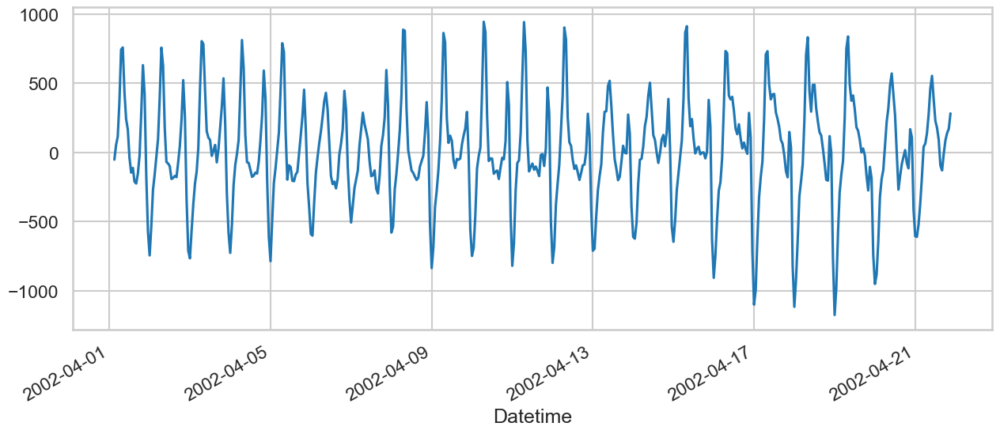

In [251]:
plt.figure(figsize=(15,6))
df['differnce-2'].iloc[:500].plot()

<AxesSubplot:xlabel='Datetime'>

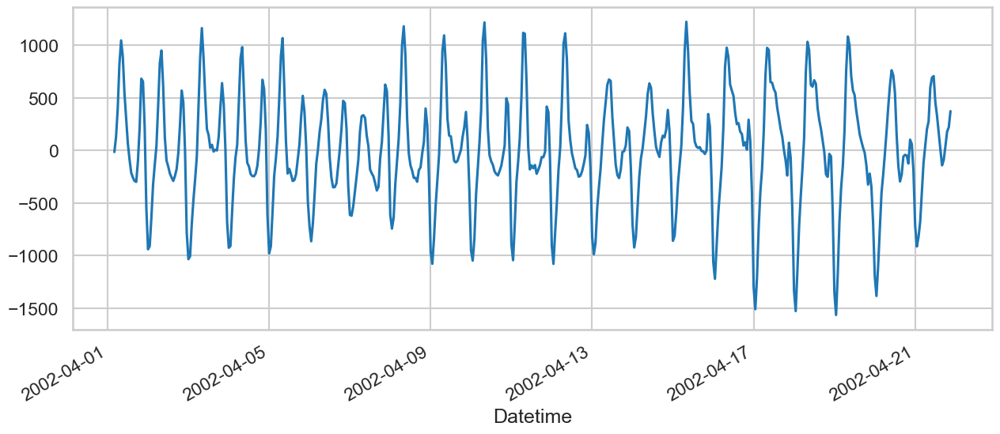

In [252]:
plt.figure(figsize=(15,6))
df['differnce-3'].iloc[:500].plot()

In [253]:
df.head()

,PJMW_MW,diff1,differnce-1,differnce-2,differnce-3
Datetime,,,,,
2002-04-01 01:00:00,4374,-320.0,NaN,NaN,NaN
2002-04-01 02:00:00,4306,-68.0,-68.0,NaN,NaN
2002-04-01 03:00:00,4322,16.0,16.0,-52.0,NaN
2002-04-01 04:00:00,4359,37.0,37.0,53.0,-15.0
2002-04-01 05:00:00,4436,77.0,77.0,114.0,130.0


In [254]:
df=df.sort_values('Datetime')

In [255]:
#Spliting the data as Train and test data

train=df.iloc[:len(df)-13920,:]
test=df.iloc[len(df)-13920:,:]
print(f'training size of data is around {len(train)}')
print(f'testing size of data is around {len(test)}')      

training size of data is around 129286
testing size of data is around 13920


In [256]:
train=train.sort_values('Datetime')

In [257]:
test=test.sort_values('Datetime')

# this plots indicates that after applying diff (pjmw) data transformed as shown below

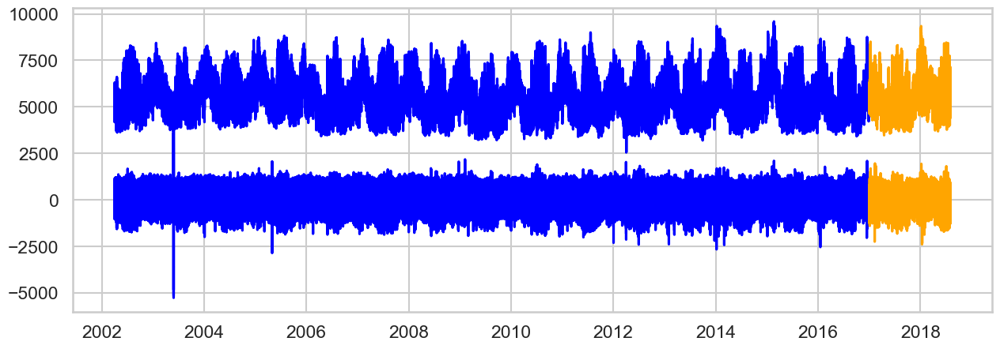

In [258]:
plt.figure(figsize=(15,5))
plt.plot(train,c='blue')
plt.plot(test,c='orange')
plt.show()

# this plots show how data size will reduce after diff

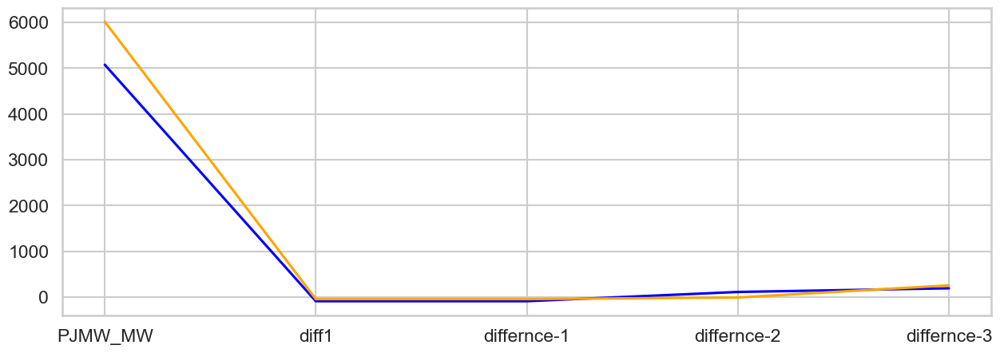

In [259]:
plt.figure(figsize=(15,5))
plt.plot(train.iloc[500],c='blue')
plt.plot(test.iloc[500],c='orange')
plt.show()

In [260]:
train_data=train['differnce-1']
_train=train['PJMW_MW']

In [261]:
train_data

Datetime
2002-04-01 01:00:00      NaN
2002-04-01 02:00:00    -68.0
2002-04-01 03:00:00     16.0
2002-04-01 04:00:00     37.0
2002-04-01 05:00:00     77.0
                       ...  
2016-12-30 19:00:00     12.0
2016-12-30 20:00:00    -63.0
2016-12-30 21:00:00    -98.0
2016-12-30 22:00:00   -183.0
2016-12-30 23:00:00   -236.0
Name: differnce-1, Length: 129286, dtype: float64

In [262]:
train=train.dropna()
train

,PJMW_MW,diff1,differnce-1,differnce-2,differnce-3
Datetime,,,,,
2002-04-01 04:00:00,4359,37.0,37.0,53.0,-15.0
2002-04-01 05:00:00,4436,77.0,77.0,114.0,130.0
2002-04-01 06:00:00,4723,287.0,287.0,364.0,401.0
2002-04-01 07:00:00,5180,457.0,457.0,744.0,821.0
2002-04-01 08:00:00,5482,302.0,302.0,759.0,1046.0
...,...,...,...,...,...
2016-12-30 19:00:00,6893,12.0,12.0,433.0,576.0
2016-12-30 20:00:00,6830,-63.0,-63.0,-51.0,370.0
2016-12-30 21:00:00,6732,-98.0,-98.0,-161.0,-149.0


In [263]:
test_data=test['differnce-1']
_test=test['PJMW_MW']#this is mainly used for ploting

In [264]:
test_data

Datetime
2016-12-31 00:00:00   -287.0
2016-12-31 01:00:00   -282.0
2016-12-31 02:00:00    -80.0
2016-12-31 03:00:00    -45.0
2016-12-31 04:00:00     24.0
                       ...  
2018-08-02 20:00:00   -148.0
2018-08-02 21:00:00    -49.0
2018-08-02 22:00:00   -171.0
2018-08-02 23:00:00   -433.0
2018-08-03 00:00:00   -403.0
Name: differnce-1, Length: 13920, dtype: float64

<AxesSubplot:xlabel='Datetime'>

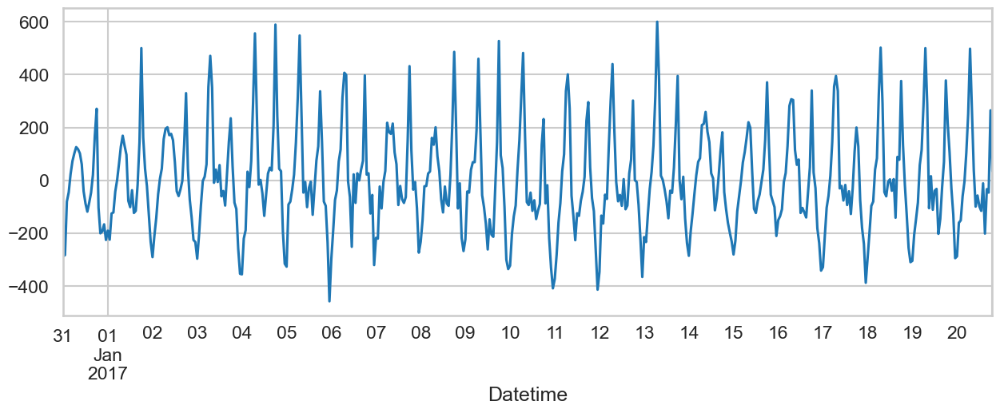

In [265]:
plt.figure(figsize=(15,5))
test_data.iloc[:500].plot()

Autoregressive (AR) model
Moving average (MA) model
 Simple Moving Average (SMA)
 Weighted Moving Average
Autoregressive moving average (ARMA) model
Autoregressive integrated moving average (ARIMA) model
Seasonal autoregressive integrated moving average (SARIMA) model
Vector autoregressive (VAR) model
Vector error correction (VECM) model

# Autoregressive model

an autoregressive model is a type of time series model that predicts future values of variables based on its own past values.
auto regressive models are commonly used for forcasting in various fields such as economics,finance and meterology

In a multiple regression model, we forecast the variable of interest using a linear combination of predictors. In an autoregression model, we forecast the variable of interest using a linear combination of past values of the variable.

In [110]:
#importing lib's for model building

from statsmodels.tsa.holtwinters import SimpleExpSmoothing, Holt
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.arima_model import ARIMA
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

In [111]:
from statsmodels.tsa.ar_model import AutoReg

In [112]:
import warnings
warnings.filterwarnings('ignore')

In [268]:
train_data=train_data.dropna()

In [269]:
#Auto regressive (AR model)

model=AutoReg(train_data,lags=79)
results=model.fit()
print(f'value of the aic is :{results.aic}')#Akaike information criterion
print(f'value of the bic is :{results.bic}')#bayesiam information criterion


value of the aic is :1503130.8038065685
value of the bic is :1503922.1060345878


In [270]:
ypred=results.forecast(len(test_data))
ypred

129285   -281.719120
129286   -211.818157
129287   -114.834405
129288    -59.500353
129289     -7.087099
             ...    
143200      0.002519
143201      0.002703
143202      0.002986
143203      0.003367
143204      0.003830
Length: 13920, dtype: float64

In [271]:
test_data

Datetime
2016-12-31 00:00:00   -287.0
2016-12-31 01:00:00   -282.0
2016-12-31 02:00:00    -80.0
2016-12-31 03:00:00    -45.0
2016-12-31 04:00:00     24.0
                       ...  
2018-08-02 20:00:00   -148.0
2018-08-02 21:00:00    -49.0
2018-08-02 22:00:00   -171.0
2018-08-02 23:00:00   -433.0
2018-08-03 00:00:00   -403.0
Name: differnce-1, Length: 13920, dtype: float64

In [272]:
test['pred']=ypred.values

In [273]:
test.head()

,PJMW_MW,diff1,differnce-1,differnce-2,differnce-3,pred
Datetime,,,,,,
2016-12-31 00:00:00,6026,-287.0,-287.0,-523.0,-706.0,-281.719120
2016-12-31 01:00:00,5744,-37.0,-282.0,-569.0,-805.0,-211.818157
2016-12-31 02:00:00,5664,-80.0,-80.0,-362.0,-649.0,-114.834405
2016-12-31 03:00:00,5619,-45.0,-45.0,-125.0,-407.0,-59.500353
2016-12-31 04:00:00,5643,24.0,24.0,-21.0,-101.0,-7.087099


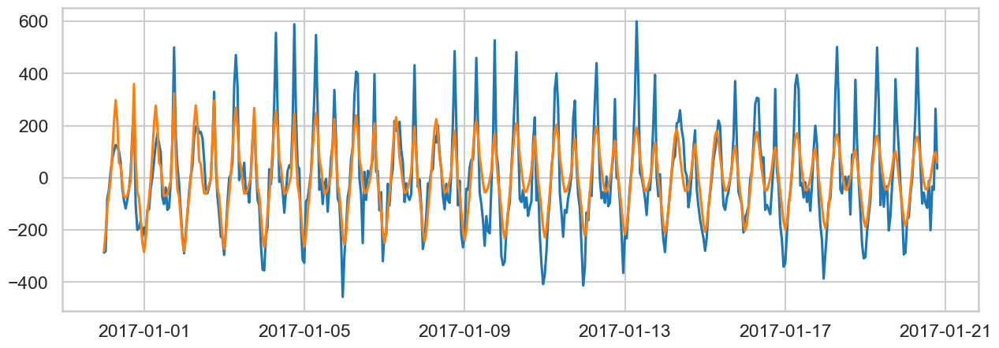

In [277]:
plt.figure(figsize=(15,5))
plt.plot(test['differnce-1'].iloc[:500])
plt.plot(test.pred.iloc[:500])

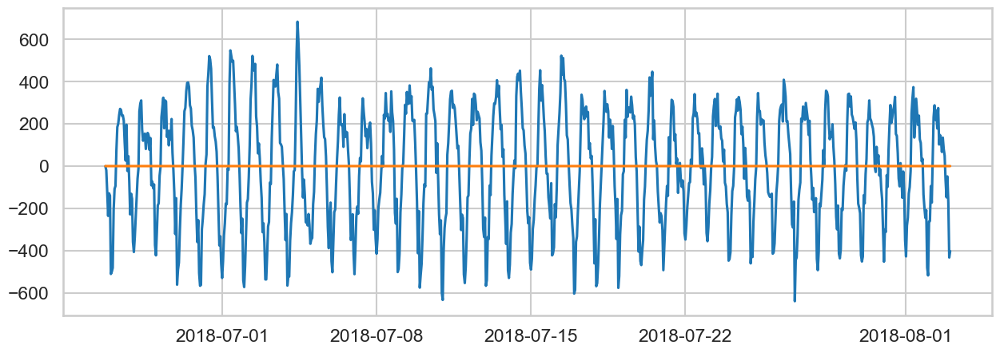

In [275]:
plt.figure(figsize=(15,5))
plt.plot(test['differnce-1'].iloc[13000:])
plt.plot(test.pred.iloc[13000:])

In [276]:
AR_mean_square_error=np.sqrt(mean_squared_error(test_data,ypred))
AR_mean_square_error

200.1737742473314

In [152]:
#now i will use diff data for 3 time and build the AR model
#let me check how it looks
test_1=test['differnce-3']
test_1=test_1.dropna()
test_1
train_1=train['differnce-3']
train_1=train_1.dropna()
train_1

Datetime
2002-04-01 01:00:00   -1086.0
2002-04-01 02:00:00    -711.0
2002-04-01 03:00:00    -372.0
2002-04-01 04:00:00     -15.0
2002-04-01 05:00:00     130.0
                        ...  
2016-12-30 19:00:00     576.0
2016-12-30 20:00:00     370.0
2016-12-30 21:00:00    -149.0
2016-12-30 22:00:00    -344.0
2016-12-30 23:00:00    -517.0
Name: differnce-3, Length: 129283, dtype: float64

In [153]:
#let me build the model for that
model=AutoReg(train_1,lags=79)
results=model.fit()
print(f'value of the aic is :{results.aic}')#Akaike information criterion
print(f'value of the bic is :{results.bic}')#bayesiam information criterion


value of the aic is :1667407.8908238793
value of the bic is :1668199.1917980772


In [154]:
#here i am predicting the values
ypred_1=results.forecast(len(test_1))
ypred_1

129283   -665.648556
129284   -385.452406
129285   -299.065855
129286   -159.646791
129287   -273.541044
             ...    
143198      0.022879
143199      0.022875
143200      0.022873
143201      0.022873
143202      0.022876
Length: 13920, dtype: float64

In [155]:
test['pred_3']=ypred_1.values
test.head()

,PJMW_MW,differnce-1,differnce-2,differnce-3,pred,pred_3
Datetime,,,,,,
2016-12-31 00:00:00,6026,-287.0,-523.0,-706.0,-302.982997,-665.648556
2016-12-31 01:00:00,5744,-37.0,-257.0,-490.0,67.145230,-385.452406
2016-12-31 02:00:00,5664,-80.0,-117.0,-337.0,-133.788350,-299.065855
2016-12-31 03:00:00,5619,-45.0,-125.0,-162.0,-107.227766,-159.646791
2016-12-31 04:00:00,5643,24.0,-21.0,-101.0,-11.962565,-273.541044


In [156]:
np.sqrt(mean_squared_error(test_data,ypred_1))

237.00138980739786

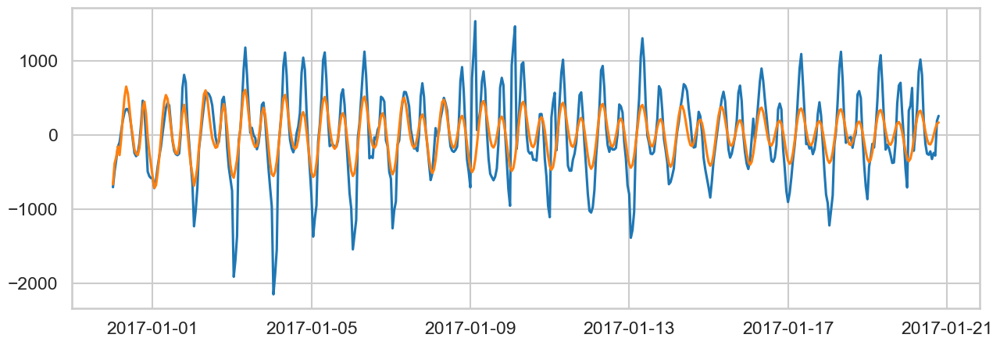

In [157]:
plt.figure(figsize=(15,5))
plt.plot(test['differnce-3'].iloc[:500])
plt.plot(test.pred_3.iloc[:500])

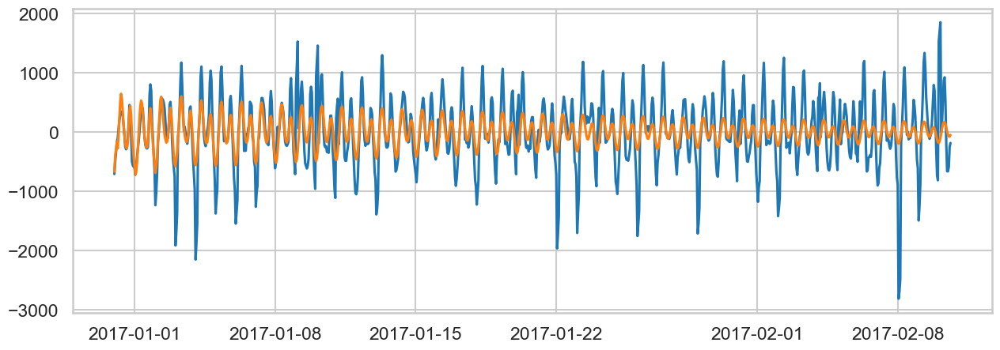

In [158]:
plt.figure(figsize=(15,5))
plt.plot(test['differnce-3'].iloc[:1000])
plt.plot(test.pred_3.iloc[:1000])

Moving average (MA) model
 Simple Moving Average (SMA)
 Weighted Moving Average
Autoregressive moving average (ARMA) model
Autoregressive integrated moving average (ARIMA) model
Seasonal autoregressive integrated moving average (SARIMA) model

# Simple Exponential smoothing

In [159]:
df=pd.read_excel('PJMW_MW_Hourly.xlsx')

In [160]:
df['diff1']=df['PJMW_MW'].diff()

In [161]:
df=df.set_index('Datetime')

In [162]:
df=df.resample(rule='D').mean()
df.shape

(5969, 2)

In [163]:
#Spliting the data as Train and test data

train=df.iloc[:len(df)-580,:]
test=df.iloc[len(df)-580:,:]
print(f'training size of data is around {len(train)}')
print(f'testing size of data is around {len(test)}')      

training size of data is around 5389
testing size of data is around 580


In [164]:
train=train.sort_values('Datetime')
test=test.sort_values('Datetime')
train=train.dropna()
test=test.dropna()

In [165]:
ses_model = SimpleExpSmoothing(train["diff1"]).fit(smoothing_level=0.1)
pred_ses = ses_model.predict(start = test.index[0],end = test.index[-1])

In [166]:
pred_ses

2017-01-01   -1.082288
2017-01-02   -1.082288
2017-01-03   -1.082288
2017-01-04   -1.082288
2017-01-05   -1.082288
                ...   
2018-07-30   -1.082288
2018-07-31   -1.082288
2018-08-01   -1.082288
2018-08-02   -1.082288
2018-08-03   -1.082288
Freq: D, Length: 580, dtype: float64

In [167]:
np.sqrt(mean_squared_error(test['diff1'],pred_ses))

24.820352361387908

In [168]:
test['ses_pred']=pred_ses

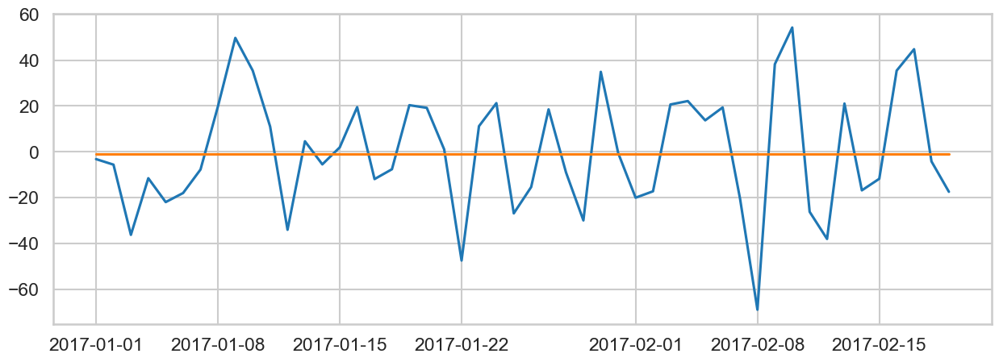

In [169]:
plt.figure(figsize=(15,5))
plt.plot(test.diff1.iloc[:50])
plt.plot(test.ses_pred.iloc[:50])

In [170]:
#Spliting the data as Train and test data
df=pd.read_excel('PJMW_MW_Hourly.xlsx')
df['diff1']=df['PJMW_MW'].diff()
df=df.set_index('Datetime')
train1=df.iloc[:len(df)-13920,:]
test1=df.iloc[len(df)-13920:,:]
print(f'training size of data is around {len(train1)}')
print(f'testing size of data is around {len(test1)}')
train1=train1.sort_values('Datetime')
test1=test1.sort_values('Datetime')
train1=train1.dropna()
test1=test1.dropna()

training size of data is around 129286
testing size of data is around 13920


#building new model and applying for the whole data

In [171]:
ses_model = SimpleExpSmoothing(np.asarray(train1['diff1'])).fit(smoothing_level=0.6,optimized=False)
pred_ses =ses_model.forecast(len(test1['diff1']))

In [172]:
test1['ses_pred']=pred_ses

In [173]:
test1

,PJMW_MW,diff1,ses_pred
Datetime,,,
2016-01-01 01:00:00,4965,-628.0,-194.229915
2016-01-01 02:00:00,4891,-74.0,-194.229915
2016-01-01 03:00:00,4831,-60.0,-194.229915
2016-01-01 04:00:00,4727,-104.0,-194.229915
2016-01-01 05:00:00,4735,8.0,-194.229915
...,...,...,...
2018-08-02 20:00:00,6545,-148.0,-194.229915
2018-08-02 21:00:00,6496,-49.0,-194.229915
2018-08-02 22:00:00,6325,-171.0,-194.229915


In [175]:
SEM_mean_square_error=np.sqrt(mean_squared_error(test1['diff1'],pred_ses))
SEM_mean_square_error

309.5894331966249

# Holt method 

In [176]:
# Holt method 
hw_model = Holt(train1['diff1']).fit(smoothing_level=0.3, smoothing_slope=0.05)
pred_hw = hw_model.forecast(len(test1)) 

In [177]:
pred_hw

129285      -172.791235
129286      -180.566539
129287      -188.341843
129288      -196.117147
129289      -203.892451
              ...      
143200   -108366.145252
143201   -108373.920556
143202   -108381.695860
143203   -108389.471164
143204   -108397.246468
Length: 13920, dtype: float64

In [178]:
test1['holt_pred']=pred_hw.values

In [179]:
test1

,PJMW_MW,diff1,ses_pred,holt_pred
Datetime,,,,
2016-01-01 01:00:00,4965,-628.0,-194.229915,-172.791235
2016-01-01 02:00:00,4891,-74.0,-194.229915,-180.566539
2016-01-01 03:00:00,4831,-60.0,-194.229915,-188.341843
2016-01-01 04:00:00,4727,-104.0,-194.229915,-196.117147
2016-01-01 05:00:00,4735,8.0,-194.229915,-203.892451
...,...,...,...,...
2018-08-02 20:00:00,6545,-148.0,-194.229915,-108366.145252
2018-08-02 21:00:00,6496,-49.0,-194.229915,-108373.920556
2018-08-02 22:00:00,6325,-171.0,-194.229915,-108381.695860


In [180]:
np.sqrt(mean_squared_error(test1['diff1'],pred_hw))

62634.86629527208

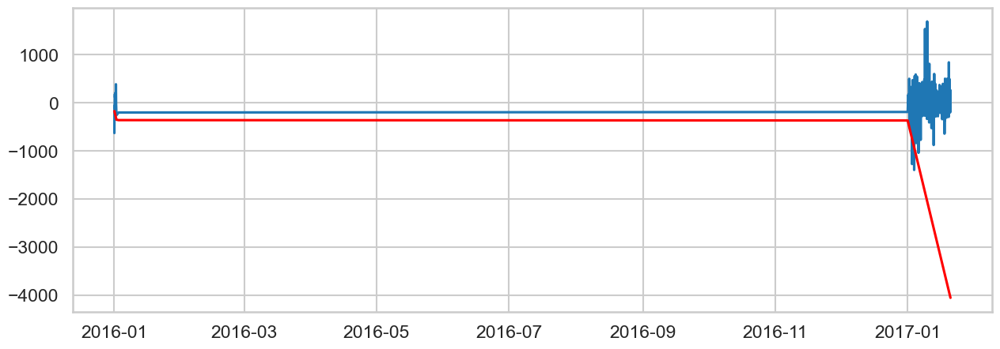

In [181]:
plt.figure(figsize=(15,5))
plt.plot(test1.diff1.iloc[:500])
plt.plot(test1.holt_pred.iloc[:500],c='red')

In [182]:
# Holt method 
hw_model = Holt(train['diff1']).fit(smoothing_level=0.3, smoothing_slope=0.05)
pred_hw = hw_model.forecast(len(test)) 

In [183]:
test['holt_pred']=pred_hw.values
test

,PJMW_MW,diff1,ses_pred,holt_pred
Datetime,,,,
2017-01-01,5128.000000,-3.166667,-1.082288,-5.040713
2017-01-02,5417.833333,-5.583333,-1.082288,-5.295293
2017-01-03,5827.500000,-36.208333,-1.082288,-5.549872
2017-01-04,5961.833333,-11.500000,-1.082288,-5.804452
2017-01-05,6939.583333,-21.916667,-1.082288,-6.059032
...,...,...,...,...
2018-07-30,5492.708333,-8.125000,-1.082288,-151.424070
2018-07-31,5660.750000,-1.875000,-1.082288,-151.678650
2018-08-01,5959.708333,-1.500000,-1.082288,-151.933230


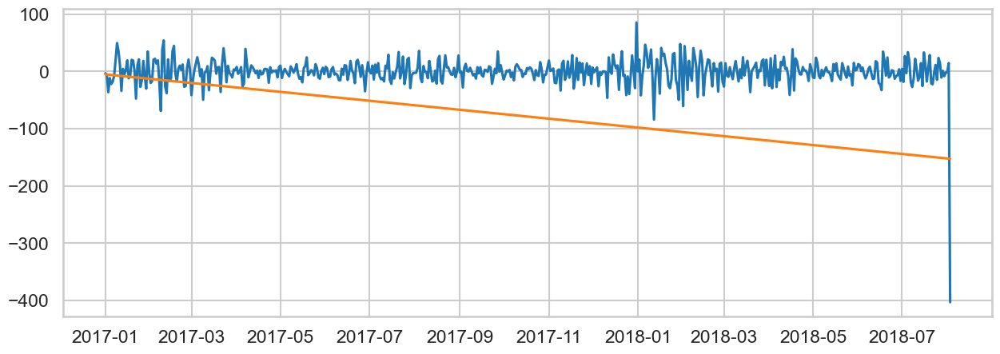

In [184]:
plt.figure(figsize=(15,5))
plt.plot(test['diff1'])
plt.plot(test['holt_pred'])

In [185]:
np.sqrt(mean_squared_error(test['diff1'],pred_hw))

91.97729135910956

# Holts winter exponential smoothing with additive seasonality and additive trend

In [186]:
#Holts winter exponential smoothing with additive seasonality and additive trend
hwe_model_add_add = ExponentialSmoothing(train1["diff1"],seasonal="add",trend="add",seasonal_periods=12).fit() #add the trend to the model
pred=hwe_model_add_add.forecast(len(test1))

In [187]:
test1['holt_as_at_pred']=pred.values

In [188]:
test1

,PJMW_MW,diff1,ses_pred,holt_pred,holt_as_at_pred
Datetime,,,,,
2016-01-01 01:00:00,4965,-628.0,-194.229915,-172.791235,-204.113042
2016-01-01 02:00:00,4891,-74.0,-194.229915,-180.566539,-153.526765
2016-01-01 03:00:00,4831,-60.0,-194.229915,-188.341843,-94.624641
2016-01-01 04:00:00,4727,-104.0,-194.229915,-196.117147,-28.240768
2016-01-01 05:00:00,4735,8.0,-194.229915,-203.892451,112.925725
...,...,...,...,...,...
2018-08-02 20:00:00,6545,-148.0,-194.229915,-108366.145252,61.921986
2018-08-02 21:00:00,6496,-49.0,-194.229915,-108373.920556,-40.732814
2018-08-02 22:00:00,6325,-171.0,-194.229915,-108381.695860,-134.364199


In [189]:
#Holts winter exponential smoothing with additive seasonality and additive trend¶
holt_es_ad_ad_mean_square_error=np.sqrt(mean_squared_error(test1['diff1'],pred))
holt_es_ad_ad_mean_square_error

235.98349641584028

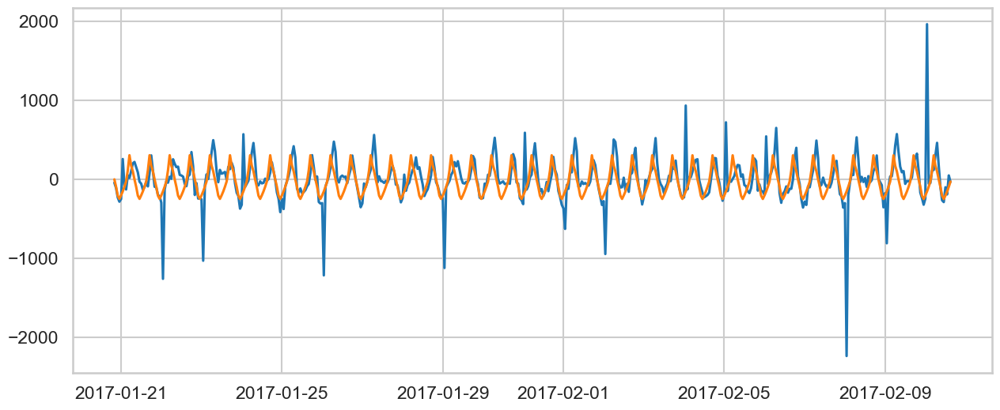

In [190]:
#lets plot
plt.figure(figsize=(15,6))
plt.plot(test1['diff1'].iloc[500:1000])
plt.plot(test1['holt_as_at_pred'].iloc[500:1000])

In [191]:
hwe_model_add_add = ExponentialSmoothing(train["diff1"],seasonal="add",trend="add",seasonal_periods=12).fit() #add the trend to the model
pred=hwe_model_add_add.forecast(len(test))

In [192]:
test['holt_as_at_pred']=pred.values

In [193]:
np.sqrt(mean_squared_error(test['diff1'],pred))

24.946102966677792

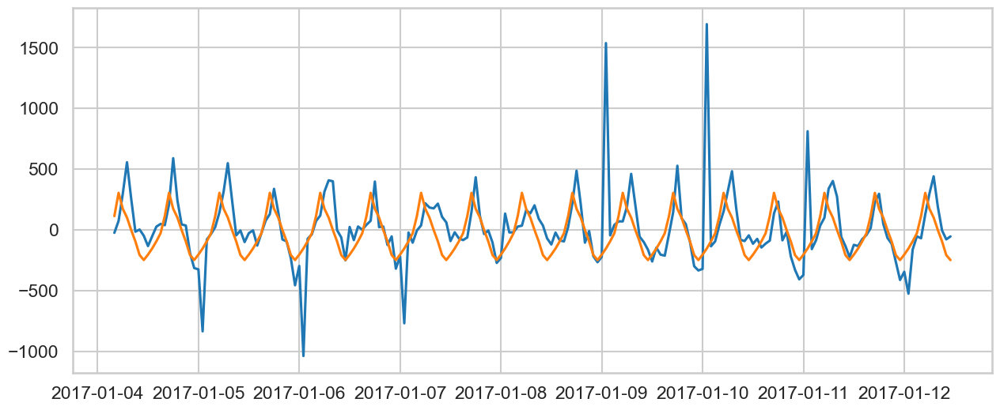

In [194]:
#lets plot
plt.figure(figsize=(15,6))
plt.plot(test1['diff1'].iloc[100:300])
plt.plot(test1['holt_as_at_pred'].iloc[100:300])

Holts winter exponential smoothing with multiplicative seasonality and additive trend are not possible because of negitive values

# Arima

In [195]:
from statsmodels.tsa.arima.model import ARIMA

In [196]:
model_ARIMA=ARIMA(train1['diff1'],order=(3,1,3))

In [197]:
model_Arima_fit=model_ARIMA.fit()

In [198]:
model_Arima_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  diff1   No. Observations:               129285
Model:                 ARIMA(3, 1, 3)   Log Likelihood             -863992.314
Date:                Tue, 04 Apr 2023   AIC                        1727998.628
Time:                        18:16:16   BIC                        1728067.017
Sample:                             0   HQIC                       1728019.146
                             - 129285                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.3761      0.001  -1109.662      0.000      -1.379      -1.374
ar.L2          0.2386      0.002    107.494      0.000       0.234       0.243
ar.L3          0.6170      0.001    560.623      0.000       0.615       0.619
ma.L1          0.9878      0.002    579.614      0.000       0.984       0.991
ma.L2         -0.9985      0.003   -338.846      0.000      -1.004      -0.993
ma.L3         -0.9892      0.002   -596.883      0.000      -0.992      -0.986
sigma2      3.741e+04   2.35e-07   1.59e+11      0.000    3.74e+04    3.74e+04
===================================================================================
Ljung-Box (L1) (Q):                  19.08   Jarque-Bera (JB):           1060713.06
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.10   Skew:                            -0.26
Prob(H) (two-sided):                  0.00   Kurtosis:                        17.02
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.18e+24. Standard errors may be unstable.
"""

In [199]:
Arima_pred=model_Arima_fit.forecast(len(test1))

In [200]:
test1['Arima_pred']=Arima_pred.values

In [201]:
test1

,PJMW_MW,diff1,ses_pred,holt_pred,holt_as_at_pred,Arima_pred
Datetime,,,,,,
2016-01-01 01:00:00,4965,-628.0,-194.229915,-172.791235,-204.113042,-117.255288
2016-01-01 02:00:00,4891,-74.0,-194.229915,-180.566539,-153.526765,-72.259570
2016-01-01 03:00:00,4831,-60.0,-194.229915,-188.341843,-94.624641,-45.783288
2016-01-01 04:00:00,4727,-104.0,-194.229915,-196.117147,-28.240768,-26.593504
2016-01-01 05:00:00,4735,8.0,-194.229915,-203.892451,112.925725,-18.918308
...,...,...,...,...,...,...
2018-08-02 20:00:00,6545,-148.0,-194.229915,-108366.145252,61.921986,-0.000822
2018-08-02 21:00:00,6496,-49.0,-194.229915,-108373.920556,-40.732814,-0.000822
2018-08-02 22:00:00,6325,-171.0,-194.229915,-108381.695860,-134.364199,-0.000822


In [202]:
arima_mean_square_error=np.sqrt(mean_squared_error(test1['diff1'],Arima_pred))

In [203]:
arima_mean_square_error

240.93952759423692

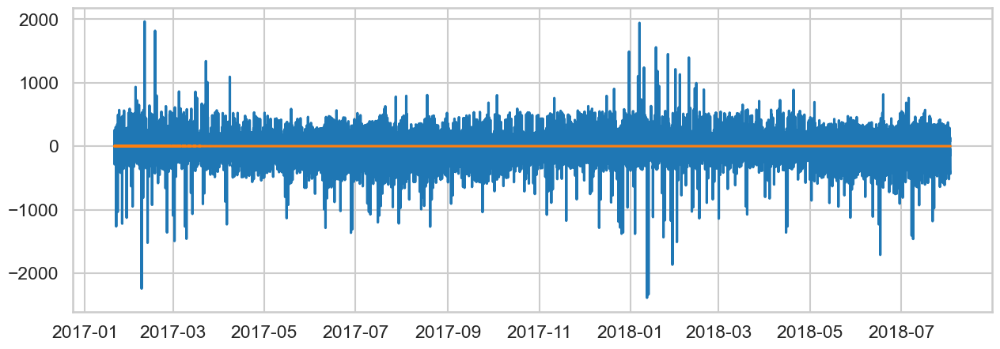

In [204]:
plt.figure(figsize=(15,5))
plt.plot(test1['diff1'].iloc[500:])
plt.plot(test1['Arima_pred'].iloc[500:])

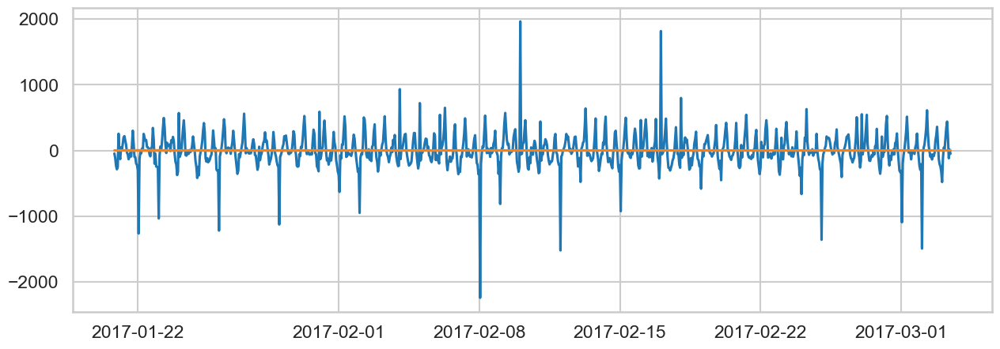

In [205]:
plt.figure(figsize=(15,5))
plt.plot(test1['diff1'].iloc[500:1500])
plt.plot(test1['Arima_pred'].iloc[500:1500])

In [206]:
## create a SARIMA model
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [207]:
model_SARIMA=SARIMAX(train1['diff1'],order=(3,0,5),seasonal_order=(0,1,0,12))

In [208]:
model_SARIMA_fit=model_SARIMA.fit()

In [209]:
model_SARIMA_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                               diff1   No. Observations:               129285
Model:             SARIMAX(3, 0, 5)x(0, 1, [], 12)   Log Likelihood             -898576.237
Date:                             Tue, 04 Apr 2023   AIC                        1797170.473
Time:                                     18:27:56   BIC                        1797258.400
Sample:                                          0   HQIC                       1797196.853
                                          - 129285                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2578      0.003    -98.208      0.000      -0.263      -0.253
ar.L2         -0.2509      0.003    -95.383      0.000      -0.256      -0.246
ar.L3          0.2196      0.002     95.896      0.000       0.215       0.224
ma.L1          0.8164      0.002    336.770      0.000       0.812       0.821
ma.L2          0.8587      0.003    329.938      0.000       0.854       0.864
ma.L3          0.4791      0.003    145.865      0.000       0.473       0.486
ma.L4          0.6564      0.002    264.151      0.000       0.652       0.661
ma.L5          0.6119      0.002    375.109      0.000       0.609       0.615
sigma2      5.268e+04     92.922    566.973      0.000    5.25e+04    5.29e+04
===================================================================================
Ljung-Box (L1) (Q):                  18.70   Jarque-Bera (JB):            158671.37
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.13   Skew:                             0.15
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.42
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [210]:
sarima_pred=model_SARIMA_fit.forecast(len(test1))

In [211]:
sarima_pred

129285    -60.695891
129286     36.119402
129287     78.518065
129288    139.257153
129289    210.838643
             ...    
143200   -191.451175
143201   -202.981805
143202   -161.496130
143203   -221.779692
143204   -194.152407
Name: predicted_mean, Length: 13920, dtype: float64

In [212]:
sarima_mean_square_error=np.sqrt(mean_squared_error(test1['diff1'],sarima_pred))
sarima_mean_square_error

285.78991693131724

In [213]:
test1['sarima_pred']=sarima_pred.values

In [214]:
test1

,PJMW_MW,diff1,ses_pred,holt_pred,holt_as_at_pred,Arima_pred,sarima_pred
Datetime,,,,,,,
2016-01-01 01:00:00,4965,-628.0,-194.229915,-172.791235,-204.113042,-117.255288,-60.695891
2016-01-01 02:00:00,4891,-74.0,-194.229915,-180.566539,-153.526765,-72.259570,36.119402
2016-01-01 03:00:00,4831,-60.0,-194.229915,-188.341843,-94.624641,-45.783288,78.518065
2016-01-01 04:00:00,4727,-104.0,-194.229915,-196.117147,-28.240768,-26.593504,139.257153
2016-01-01 05:00:00,4735,8.0,-194.229915,-203.892451,112.925725,-18.918308,210.838643
...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545,-148.0,-194.229915,-108366.145252,61.921986,-0.000822,-191.451175
2018-08-02 21:00:00,6496,-49.0,-194.229915,-108373.920556,-40.732814,-0.000822,-202.981805
2018-08-02 22:00:00,6325,-171.0,-194.229915,-108381.695860,-134.364199,-0.000822,-161.496130


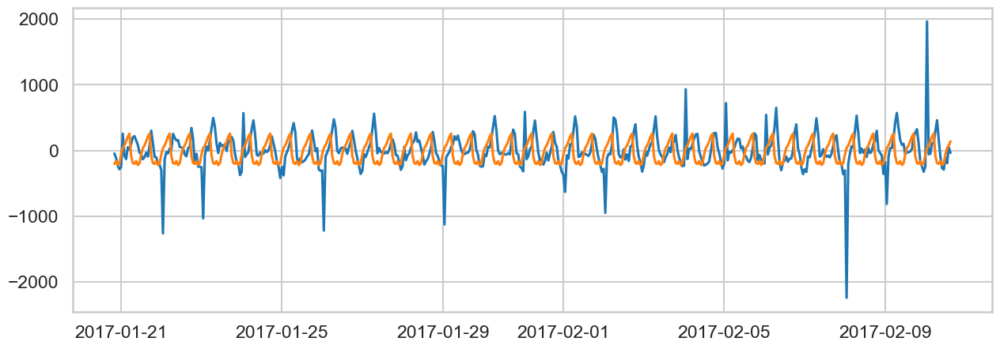

In [215]:
plt.figure(figsize=(15,5))
plt.plot(test1['diff1'].iloc[500:1000])
plt.plot(test1['sarima_pred'].iloc[500:1000])

In [217]:
#Compare the results 

data = {"MODEL":pd.Series(["AutoRegressive","Simple Exponential smoothing","Holts winter exponential smoothing with additive seasonality and additive trend","Arima","Sarima"]),"RMSE_Values":pd.Series([AR_mean_square_error,SEM_mean_square_error,holt_es_ad_ad_mean_square_error,arima_mean_square_error,sarima_mean_square_error])}
table_rmse=pd.DataFrame(data)
table_rmse.sort_values(['RMSE_Values'])

,MODEL,RMSE_Values
0,AutoRegressive,200.350000
2,Holts winter exponential smoothing with additi...,235.983496
3,Arima,240.939528
4,Sarima,285.789917
1,Simple Exponential smoothing,309.589433


# model building in xg boosting

In [2]:
#impoorting basic required lib's
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

In [3]:
#reading the datasets using pandas 
df=pd.read_excel('PJMW_MW_Hourly.xlsx')
df.head()

,Datetime,PJMW_MW
0,2002-12-31 01:00:00,5077
1,2002-12-31 02:00:00,4939
2,2002-12-31 03:00:00,4885
3,2002-12-31 04:00:00,4857
4,2002-12-31 05:00:00,4930


In [4]:
df=df.set_index('Datetime')
df=df.sort_values('Datetime')

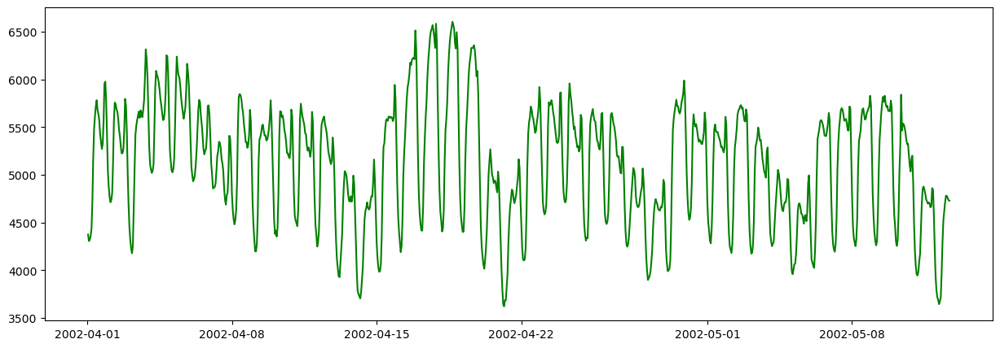

In [5]:
#ploting first 1000data let me find how data looks
plt.figure(figsize=(15,5))
plt.plot(df.iloc[:1000,0],c='green')

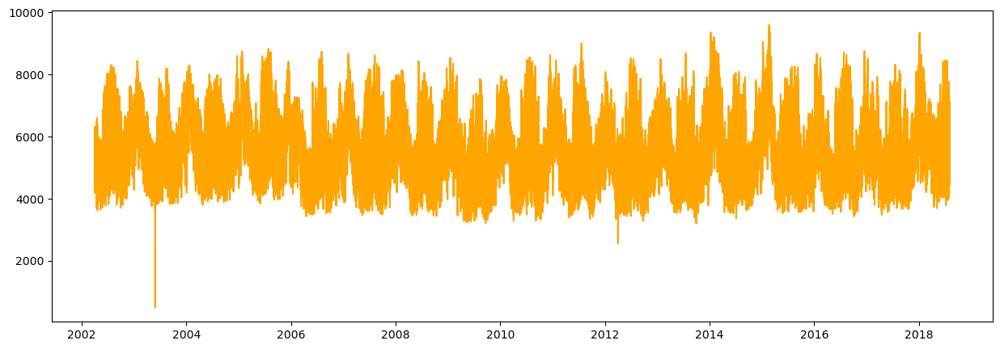

In [7]:
#ploting overall data lets find how it looks
plt.figure(figsize=(15,5))
plt.plot(df['PJMW_MW'],c='orange')

<AxesSubplot:xlabel='Datetime'>

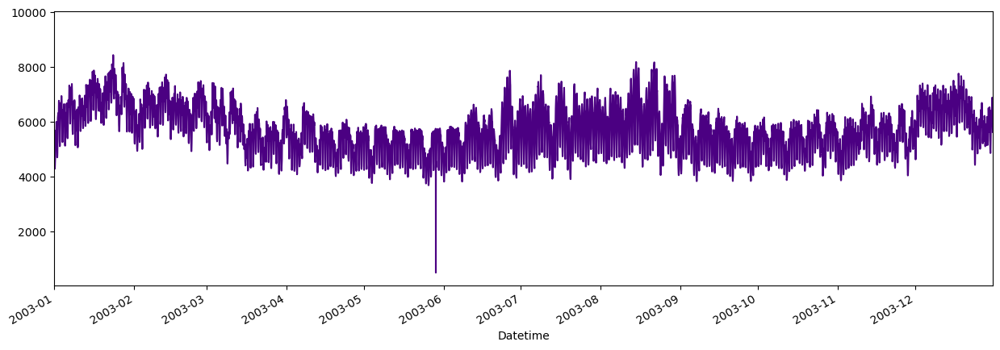

In [8]:
#from the abve plots i am finding one noise in the year 2003
#let me fix before that i need to see plot of the year 2003
plt.figure(figsize=(15,5))
df['PJMW_MW'].plot(xlim=['2003-01-01','2003-12-31'],c='indigo')

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

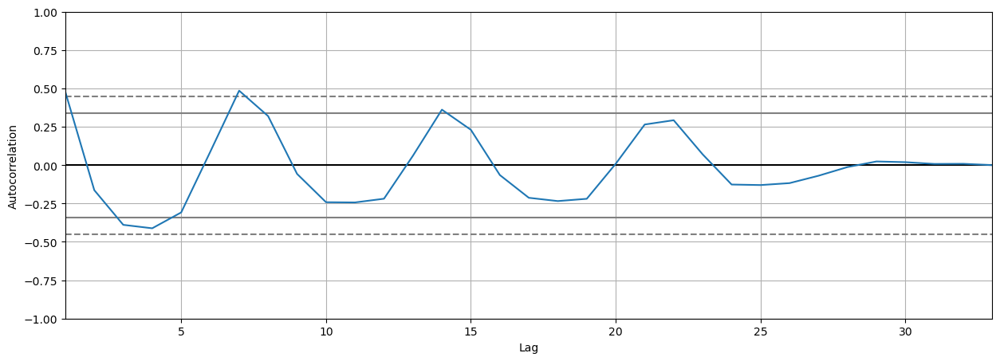

In [9]:
plt.figure(figsize=(15,5))
pd.plotting.autocorrelation_plot(df['2003-04-28':'2003-05-30']['PJMW_MW'].resample('1d').mean())

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 1)'>

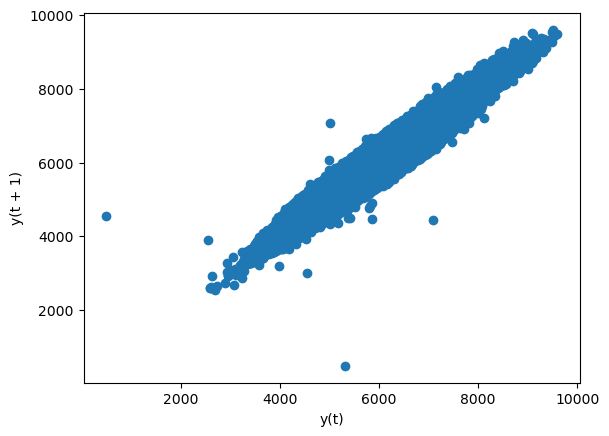

In [10]:
#this lag plots shows the autocorrelation of 1hour
pd.plotting.lag_plot(df['PJMW_MW'],lag=1)

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 24)'>

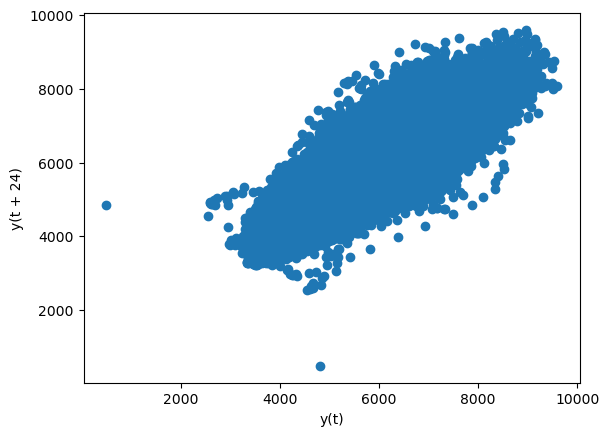

In [11]:
#this lag plots showing the 1day autocorrelation present in the data
pd.plotting.lag_plot(df['PJMW_MW'],lag=24)

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 720)'>

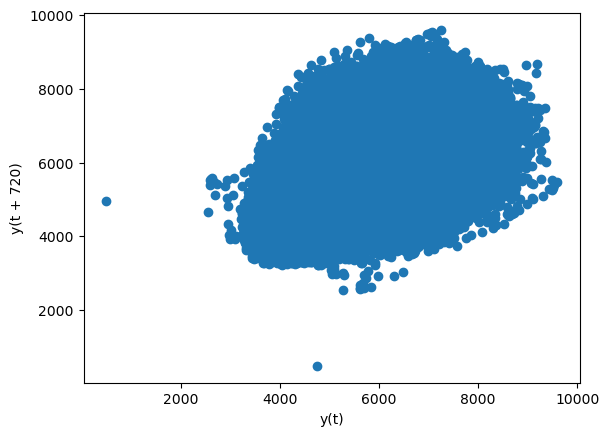

In [12]:
#this lagplots shows the autocorrelation of one month
pd.plotting.lag_plot(df['PJMW_MW'],lag=(30*24))

In [14]:
df=df.reset_index('Datetime')

In [15]:
#let me build the xg boosting model 
#for creating model i need to create some feature 

df['Day']=df['Datetime'].dt.day
df['dayofyear']=df['Datetime'].dt.dayofyear
df['quarter']=df['Datetime'].dt.quarter
df['weekofyear']=df['Datetime'].dt.week
df['year']=df['Datetime'].dt.year
df['month']=df['Datetime'].dt.month
df['hour']=df['Datetime'].dt.hour
df['name_of_week']=df['Datetime'].dt.week
df['season']=df['Datetime'].apply(lambda x: 'Winter' if x.month == 12 or x.month == 1 or x.month == 2  else 'Spring' if x.month==3 or x.month==4 or x.month==5 else 'Summer' if x.month==6 or x.month==7 or x.month==8 else 'Autumn' if x.month==9 or x.month==10 or x.month==11 else "")

C:\Users\sagar.MANJUNATH\AppData\Local\Temp\ipykernel_14160\3449727751.py:7: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['weekofyear']=df['Datetime'].dt.week
C:\Users\sagar.MANJUNATH\AppData\Local\Temp\ipykernel_14160\3449727751.py:11: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['name_of_week']=df['Datetime'].dt.week


In [16]:
import holidays

In [17]:
df=df.set_index('Datetime')

In [18]:
holidays=holidays.US()
df['holiday']=df.index.map(lambda x:x in holidays)

In [19]:
from sklearn.preprocessing import LabelEncoder

df['season']=LabelEncoder().fit_transform(df['season'])
df['holiday']=LabelEncoder().fit_transform(df['holiday'])
df.head()

,PJMW_MW,Day,dayofyear,quarter,weekofyear,year,month,hour,name_of_week,season,holiday
Datetime,,,,,,,,,,,
2002-04-01 01:00:00,4374,1,91,2,14,2002,4,1,14,1,0
2002-04-01 02:00:00,4306,1,91,2,14,2002,4,2,14,1,0
2002-04-01 03:00:00,4322,1,91,2,14,2002,4,3,14,1,0
2002-04-01 04:00:00,4359,1,91,2,14,2002,4,4,14,1,0
2002-04-01 05:00:00,4436,1,91,2,14,2002,4,5,14,1,0


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 143206 entries, 2002-04-01 01:00:00 to 2018-08-03 00:00:00
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype
---  ------        --------------   -----
 0   PJMW_MW       143206 non-null  int64
 1   Day           143206 non-null  int64
 2   dayofyear     143206 non-null  int64
 3   quarter       143206 non-null  int64
 4   weekofyear    143206 non-null  int64
 5   year          143206 non-null  int64
 6   month         143206 non-null  int64
 7   hour          143206 non-null  int64
 8   name_of_week  143206 non-null  int64
 9   season        143206 non-null  int32
 10  holiday       143206 non-null  int32
dtypes: int32(2), int64(9)
memory usage: 12.0 MB


In [21]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error

In [22]:
train = df.loc[df.index < '01-01-2017']
test = df.loc[df.index >= '01-01-2017']

In [23]:
train.shape

(129310, 11)

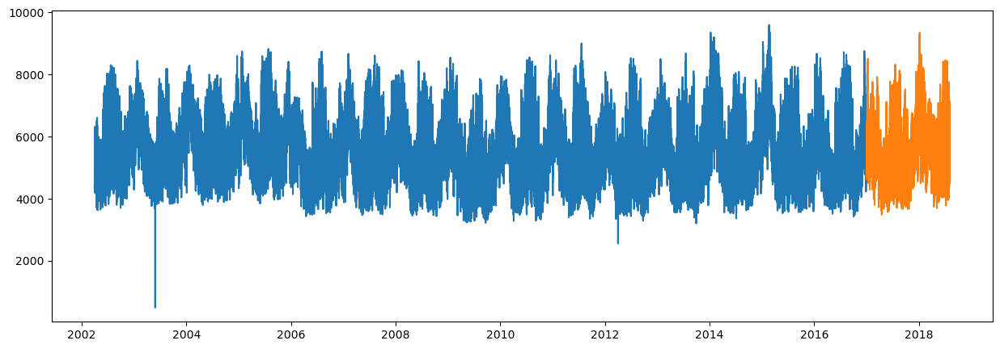

In [25]:
plt.figure(figsize=(15,5))
plt.plot(train['PJMW_MW'])
plt.plot(test['PJMW_MW'])

In [26]:
df.corr()

,PJMW_MW,Day,dayofyear,quarter,weekofyear,year,month,hour,name_of_week,season,holiday
PJMW_MW,1.000000,-0.006171,-0.150912,-0.159943,-0.151605,-0.046935,-0.152412,0.447239,-0.151605,0.420009,-0.022624
Day,-0.006171,1.000000,0.094099,0.011846,0.067337,-0.001908,0.010118,-0.000091,0.067337,-0.003960,-0.025121
dayofyear,-0.150912,0.094099,1.000000,0.967610,0.971511,-0.077337,0.996439,-0.000053,0.971511,-0.370343,0.028189
quarter,-0.159943,0.011846,0.967610,1.000000,0.945401,-0.077200,0.970842,-0.000050,0.945401,-0.384966,0.040118
weekofyear,-0.151605,0.067337,0.971511,0.945401,1.000000,-0.076219,0.970049,-0.000059,1.000000,-0.371854,0.054809
year,-0.046935,-0.001908,-0.077337,-0.077200,-0.076219,1.000000,-0.077594,-0.000141,-0.076219,0.037930,-0.001318
month,-0.152412,0.010118,0.996439,0.970842,0.970049,-0.077594,1.000000,-0.000045,0.970049,-0.373142,0.029940
hour,0.447239,-0.000091,-0.000053,-0.000050,-0.000059,-0.000141,-0.000045,1.000000,-0.000059,-0.000164,-0.000041
name_of_week,-0.151605,0.067337,0.971511,0.945401,1.000000,-0.076219,0.970049,-0.000059,1.000000,-0.371854,0.054809
season,0.420009,-0.003960,-0.370343,-0.384966,-0.371854,0.037930,-0.373142,-0.000164,-0.371854,1.000000,0.010183


In [27]:
input = ['Day','year','month','hour', 'name_of_week', 'season','holiday']
output = ['PJMW_MW']

In [28]:
X_train = train[input]
y_train = train[output]

X_test = test[input]
y_test = test[output]

In [29]:
model = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                       n_estimators=1500,
                       early_stopping_rounds=50,
                       objective='reg:linear',
                       max_depth=3,
                       learning_rate=0.01)
model.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=100)

[01:55:39] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\objective\regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:5627.98085	validation_1-rmse:5657.09042
[100]	validation_0-rmse:2153.01577	validation_1-rmse:2181.05614
[200]	validation_0-rmse:986.36825	validation_1-rmse:1038.24360
[300]	validation_0-rmse:679.18978	validation_1-rmse:766.58525
[400]	validation_0-rmse:615.19827	validation_1-rmse:722.16480
[500]	validation_0-rmse:596.73519	validation_1-rmse:713.69545
[562]	validation_0-rmse:590.88464	validation_1-rmse:713.79880


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=50,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1500, n_jobs=None, num_parallel_tree=None,
             objective='reg:linear', predictor=None, ...)

In [30]:
model.best_score

713.3331547538079

In [31]:
model.feature_importances_

array([0.01749715, 0.04706896, 0.08752433, 0.29916567, 0.06619662,
       0.46214473, 0.02040251], dtype=float32)

In [32]:
test['prediction'] = model.predict(X_test)
df = df.merge(test[['prediction']], how='left', left_index=True, right_index=True)

C:\Users\sagar.MANJUNATH\AppData\Local\Temp\ipykernel_14160\3012019967.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['prediction'] = model.predict(X_test)


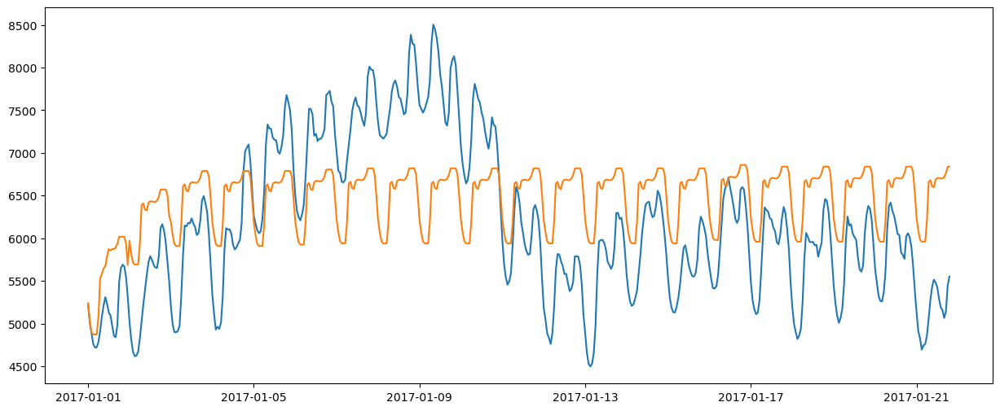

In [33]:
plt.figure(figsize=(15,6))
plt.plot(test['PJMW_MW'].iloc[0:500])
plt.plot(test['prediction'].iloc[0:500])

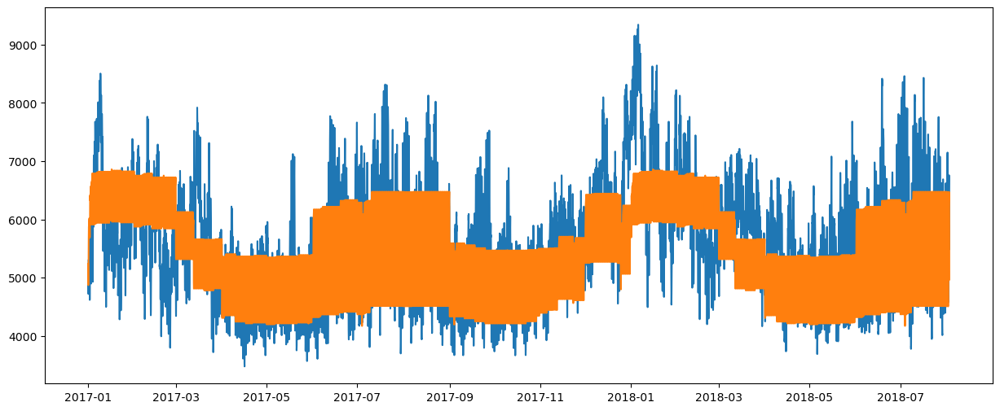

In [34]:
plt.figure(figsize=(15,6))
plt.plot(test['PJMW_MW'])
plt.plot(test['prediction'])